<div style="border:solid purple 2px; padding: 20px"> 
    
# Исследование рынка заведений общественного питания Москвы

Заказчики данного исследования - инвесторы из фонда «Shut Up and Take My Money», которые решили попробовать себя в новой области и открыть заведение общественного питания в Москве. Заказчики ещё не знают, что это будет за место: кафе, ресторан, пиццерия, паб или бар, — и какими будут расположение, меню и цены.

Для начала необходимо подготовить исследование рынка Москвы, найти интересные особенности и презентовать полученные результаты, которые в будущем помогут в выборе подходящего инвесторам места.

---
    
**Описание данных**

Нам доступен датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года. Информация, размещённая в сервисе Яндекс Бизнес, могла быть добавлена пользователями или найдена в общедоступных источниках. Она носит исключительно справочный характер.

Файл `moscow_places.csv`:

- `name` — название заведения;
- `address` — адрес заведения;
- `category` — категория заведения, например «кафе», «пиццерия» или «кофейня»;
- `hours` — информация о днях и часах работы;
- `lat` — широта географической точки, в которой находится заведение;
- `lng` — долгота географической точки, в которой находится заведение;
- `rating` — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — `5.0`);
- `price` — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;
- `avg_bill` — строка, которая хранит среднюю стоимость заказа в виде диапазона, например:
    - «Средний счёт: 1000–1500 ₽»;
    - «Цена чашки капучино: 130–220 ₽»;
    - «Цена бокала пива: 400–600 ₽».
        
        и так далее;
        
- `middle_avg_bill` — число с оценкой среднего чека, которое указано только для значений из столбца `avg_bill`, начинающихся с подстроки «Средний счёт»:
    - Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
    - Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
    - Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.
- `middle_coffee_cup` — число с оценкой одной чашки капучино, которое указано только для значений из столбца `avg_bill`, начинающихся с подстроки «Цена одной чашки капучино»:
    - Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
    - Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
    - Если значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.
- `chain` — число, выраженное `0` или `1`, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки);
- `district` — административный район, в котором находится заведение, например Центральный административный округ;
- `seats` — количество посадочных мест.
---
    
**Цель исследования**

1. Изучить рынок заведений общественного питания Москвы и выявить интересные особенности
2. Исследовать рентабельно ли будет для инвесторов открыть кофейню и дать рекомендацию для открытия нового заведения
3. Подготовить презентацию с важными тезисами исследования для инвесторов
---
    
***Ход исследования***
    
Данные о заведениях общественного питания Москвы получим из файла `/datasets/moscow_places.csv`. О качестве датасета информации нет. Перед тем как приступать к цели исследования, нам необходимо изучить данные.
    
Проверим данные на предмет ошибок и оценим их влияние на результаты исследования. В процессе преодобработки данных попробуем исправить все ошибки, которые могут привести к искажению конечного результата. Далее мы проиллюстрируем все гипотезы и выводы на подходящих графиках и приступим к исследовательскому анализу данных.
    
Таким образом, мое исследование пройдет в пять этапов:
- изучение предоставленных данных
- предобработка данных
- исследовательский анализ данных
- написание общего вывода
- составление презентации по результатам исследования

## Загрузка данных и изучение общей информации

Изучите общую информацию о датасете.
- Сколько заведений представлено?
- Что можно сказать о каждом столбце?
- Значения какого типа они хранят?

In [1]:
# импортируем необходимые нам библиотеки для анализа данных
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly import graph_objects as go
import json
import codecs
import os
import folium
from folium import Marker, Map, Choropleth
from folium.plugins import MarkerCluster

In [2]:
# читаем файл
try:
    data = pd.read_csv('/datasets/moscow_places.csv')
except:
    data = pd.read_csv('C:/Users/etols/Downloads/moscow_places.csv')

In [3]:
# выведем на экран случайные 15 строк датасета
data.sample(15)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
2000,Коптильня,ресторан,"Москва, Новослободская улица, 18",Центральный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–06:00; вс 12:00...",55.782340,37.599891,4.4,высокие,Средний счёт:от 2500 ₽,2500.0,NaN,0,307.0
4732,Cvc Китайская кухня,ресторан,"Москва, Чистопрудный бульвар, 10, стр. 1",Центральный административный округ,"ежедневно, 11:00–23:00",55.762242,37.642249,4.3,NaN,NaN,NaN,NaN,1,50.0
7190,Колизей,кафе,"Москва, 1-й Варшавский проезд, 1Ас9",Южный административный округ,пн-чт 10:00–00:00; пт-вс 10:00–05:00,55.648674,37.627979,4.0,NaN,NaN,NaN,NaN,0,NaN
7084,Тандыр,кафе,"Москва, Кировоградская улица, 3А",Южный административный округ,"ежедневно, круглосуточно",55.629605,37.613639,3.9,NaN,NaN,NaN,NaN,1,NaN
7244,Тахи,кафе,"Москва, Кавказский бульвар, 52Б",Южный административный округ,NaN,55.631239,37.645151,3.9,NaN,NaN,NaN,NaN,0,NaN
4339,Арма craft,"бар,паб","Москва, Нижний Сусальный переулок, 5, стр. 9",Центральный административный округ,пн-чт 13:00–00:00; пт 13:00–02:00; сб 14:00–02...,55.760681,37.663943,4.8,средние,Цена бокала пива:170–380 ₽,NaN,NaN,0,30.0
7418,Мерси 5 звезд,быстрое питание,"Москва, Новочеркасский бульвар, 13",Юго-Восточный административный округ,"ежедневно, 10:45–22:45",55.647422,37.723010,4.1,средние,Средний счёт:250–300 ₽,275.0,NaN,0,55.0
7021,КофеТун-СушиТун,кафе,"Москва, Профсоюзная улица, 61А",Юго-Западный административный округ,"ежедневно, 10:00–23:00",55.656158,37.540616,3.5,средние,Средний счёт:1200 ₽,1200.0,NaN,1,75.0
8153,Lollo,пиццерия,"Москва, Люсиновская улица, 62",Южный административный округ,"ежедневно, 08:00–23:00",55.717689,37.622056,4.4,NaN,NaN,NaN,NaN,0,25.0
2200,Сирийская шаурма,быстрое питание,"Москва, Рижский проезд, вл7",Северо-Восточный административный округ,"ежедневно, 08:00–21:00",55.813808,37.661098,4.2,NaN,NaN,NaN,NaN,0,NaN


***Сразу бросается в глаза большое количество пропусков, либо нам просто "повезло" со случайным образцом данных. Чуть позже посмотрим на пропуски пристальнее.***

In [4]:
#с помощью метода info изучим общую информацию о датафрейме
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


***Все столбцы имеют корректный тип данных за исключением последнего. Количество посадочных мест в столбце `seats` не может выражаться дробным числом, оно должно быть целым.***

***Тип данных возможно поменяем позднее после исследования пропусков в данных, так как в столбце с пропусками изменить тип данных не получится.***

In [5]:
# выведем на экран описательную статистику по данным
data.describe()

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,chain,seats
count,8406.000000,8406.000000,8406.000000,3149.000000,535.000000,8406.000000,4795.000000
mean,55.750109,37.608570,4.229895,958.053668,174.721495,0.381275,108.421689
std,0.069658,0.098597,0.470348,1009.732845,88.951103,0.485729,122.833396
min,55.573942,37.355651,1.000000,0.000000,60.000000,0.000000,0.000000
25%,55.705155,37.538583,4.100000,375.000000,124.500000,0.000000,40.000000
50%,55.753425,37.605246,4.300000,750.000000,169.000000,0.000000,75.000000
75%,55.795041,37.664792,4.400000,1250.000000,225.000000,1.000000,140.000000
max,55.928943,37.874466,5.000000,35000.000000,1568.000000,1.000000,1288.000000


In [6]:
# посмотрим, нет ли ошибок в написании округа, это самый немногочисленный столбец по количеству уникальных данных
data['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

***В названиях округов все в порядке, посмотрим, что у нас с уникальными названиями заведений. Сразу приведем названия к нижнему регистру для удобства работы с ними.***

In [7]:
# приведем все названия к нижнему регистру
data['name'] = data['name'].str.lower()

In [8]:
# посчитаем количество уникальных заведений, представленных в датасете
data['name'].nunique()

5512

***ВЫВОДЫ:***

- В данном датасете представлено 5512 уникальных названий заведений города Москвы.

- Столбцы с категориальными значениями, в которых хранится тип данных `object`: `name`, `category`, `address`, `district`, `hours` (столбец с часами работы заведений в данном случае относится к категориальным данным), `price` (в данном случае, также содержит категориальные данные, в столбце представлены категории цен), `avg_bill` (также категориальный столбец в данном случае, так как представлены не числа, а информация с размером среднего чека) - все столбцы имеют верный тип данных.

- Столбцы с количественными значениями, типы данных `float` и `int`: `lat`, `lng` (данные о координатах местоположения заведения), `rating`, `middle_avg_bill ` и `middle_coffee_cup` (данные о средних ценах вполне подходит вещественный тип данных), `chain`, `seats`. 

Тип данных в последнем столбце `seats` целесообразнее будет поменять, так как количество посадочных мест должно быть целым числом, а не дробным. Поменяем позднее после исследования пропусков в данных. Также данный столбец нужно будет изучить на предмет выбросов, так как судя по описательной статистике, максимальное значение в 1288 посадочных мест представляется нереальным, тем более при среднем значении в 108 мест данного столбца.

## Предобработка данных

Изучите, есть ли дубликаты в данных.
- Поищите пропуски: встречаются ли они, в каких столбцах?
- Можно ли их обработать или оставить как есть?

In [9]:
# посмотрим, в каких столбцах есть пропущенные значения и сразу посчитаем их
data.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64

***Пропусков в данных очень много:***

- пропуски в столбце `hours` заменить никакими данными не представляется возможным, так как эта информация является уникальной для каждого заведения
- пропуски в столбце `price` также заменять какими-либо усредненными данными некорректно, так как цены могут разниться в зависимости от района Москвы, в котором находится заведение. Можно было скоррелировать данные со столбцом `avg_bill`, однако в данном столбце почти столько же пропусков, что и в столбце с категорией цен
- данные из столбца `avg_bill` распределены по двум разным столбцам - `middle_avg_bill` и `middle_coffee_cup`, здесь также корректно заполнить пропуски не удастся
- данные из столбца `seats` также нет возможности заполнить, поскольку количество мест в каждом заведении может быть уникальным, однако ранее мы видели, что в данном столбце могут встретиться некорректные данные, поскольку сильно различается максимальное значение и среднее, изучим подробнее.

In [10]:
# check
# пропущенные значения бары

def pass_value_barh(dfg):
    try:
        (
            (dfg.isna().mean()*100)
            .to_frame()
            .rename(columns = {0:'space'})
            .query('space > 0')
            .sort_values(by = 'space', ascending = True)
            .plot(kind = 'barh',
                  figsize = (19,6),
                  rot = -5,
                  legend = False,
                  fontsize = 16,
                  grid = True,
                  color='#720455')
         );    
    except:
        print('пропусков не осталось :) или произошла ошибка в первой части функции ')

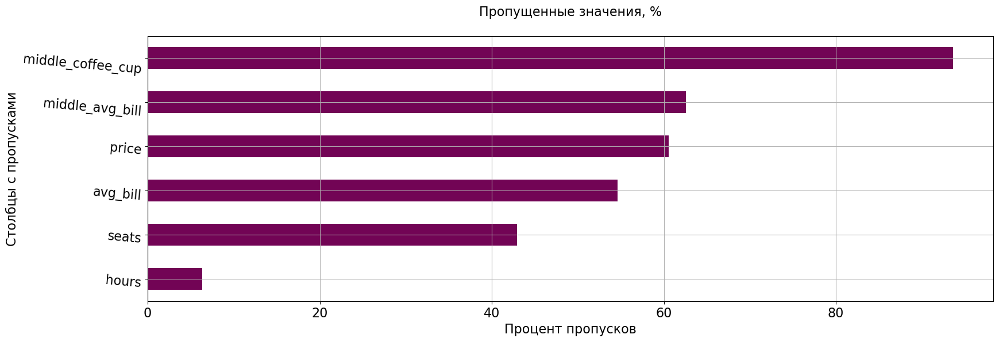

In [11]:
pass_value_barh(data)
plt.title('Пропущенные значения, %' + "\n", fontsize=16)
plt.xlabel('Процент пропусков', fontsize=16)
plt.ylabel('Столбцы с пропусками', fontsize=16)
plt.show()

In [12]:
# посмотрим описательную статистику по конкретному столбцу
data['seats'].describe()

count    4795.000000
mean      108.421689
std       122.833396
min         0.000000
25%        40.000000
50%        75.000000
75%       140.000000
max      1288.000000
Name: seats, dtype: float64

In [13]:
# сразу зададим цветовую схему для графиков
plt.style.use('bmh')

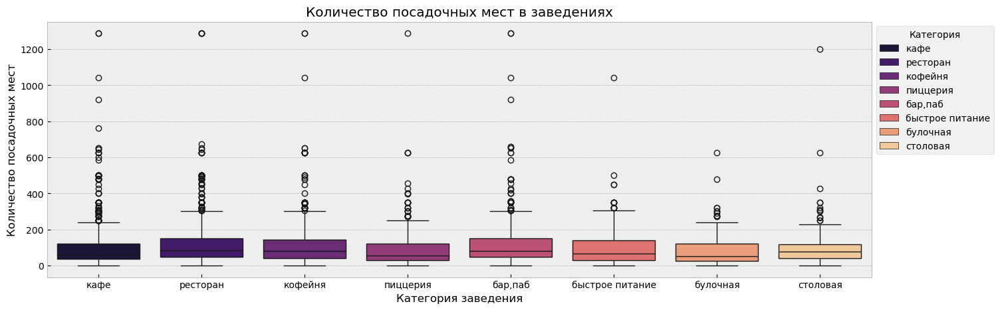

In [14]:
# сделаем диаграмму размаха и посмотрим на предмет выбросов
plt.figure(figsize=(16, 5))
(sns.boxplot(data = data, y = 'seats', x='category', hue='category', palette='magma', legend=True)
            .set(title = 'Количество посадочных мест в заведениях',
            xlabel = 'Категория заведения', ylabel = 'Количество посадочных мест'))
plt.legend(title='Категория', loc='upper left', bbox_to_anchor=(1,1))
plt.show()

***Судя по графику, выбросы действительно есть. Можно ограничить количество мест числом 500, остальное уберем. Проверим на всякий случай, сколько таких заведений.***

In [15]:
# посчитаем сколько заведений с количеством мест больше 500
data[data['seats'] > 500]['name'].count()

56

***В общем количестве значений это ничтожно малая часть, поэтому их можно исключить из анализа, на результаты повлиять они не должны.***

In [16]:
# передадим переменной диапазон данных, которые мы собираемся удалить
data_drop = data[data['seats'] > 500].index
data = data.drop(data_drop, axis=0)

In [17]:
# проверим, удалились ли необходимые нам значения
data[data['seats'] > 500]['name'].count()

0

***Посмотрим данные на наличие дубликатов: явных и неявных. Неявными дубликатами будем считать совпадения по названию, адресу заведения и округу, где оно находится.***

In [18]:
# сразу посчитаем количество явных дубликатов
data.duplicated().sum()

0

In [19]:
# далее посчитаем количество неявных дубликатов
data.duplicated(subset=['name', 'address', 'district']).sum()

3

In [20]:
# посмотрим на данные, которые определились как неявные дубликаты
data[data[['name', 'address', 'district']].duplicated(keep=False)]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1430,more poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"ежедневно, 09:00–21:00",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,0,188.0
1511,more poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00...",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,1,188.0
2211,раковарня клешни и хвосты,ресторан,"Москва, проспект Мира, 118",Северо-Восточный административный округ,"ежедневно, 12:00–00:00",55.810553,37.638161,4.4,NaN,NaN,NaN,NaN,0,150.0
2420,раковарня клешни и хвосты,"бар,паб","Москва, проспект Мира, 118",Северо-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00...",55.810677,37.638379,4.4,NaN,NaN,NaN,NaN,1,150.0
3091,хлеб да выпечка,булочная,"Москва, Ярцевская улица, 19",Западный административный округ,"ежедневно, 09:00–22:00",55.738886,37.411648,4.1,NaN,NaN,NaN,NaN,1,276.0
3109,хлеб да выпечка,кафе,"Москва, Ярцевская улица, 19",Западный административный округ,NaN,55.738449,37.410937,4.1,NaN,NaN,NaN,NaN,0,276.0


In [21]:
# удалим их
data = data.drop_duplicates(subset=['name', 'address', 'district']).reset_index(drop=True)

- Создайте столбец `street` с названиями улиц из столбца с адресом.
- Создайте столбец `is_24_7` с обозначением, что заведение работает ежедневно и круглосуточно (24/7):
    - логическое значение `True` — если заведение работает ежедневно и круглосуточно;
    - логическое значение `False` — в противоположном случае.

In [22]:
# создадим столбец с названием улицы из столбца с адресом
data['street'] = data['address'].str.split(',').str[1].str.strip()

In [23]:
data[data['street'] == 'проспект Мира']

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street
718,все лень,ресторан,"Москва, проспект Мира, 119, стр. 528",Северо-Восточный административный округ,"пн-чт 12:00–21:00; пт,сб 12:00–22:00; вс 12:00...",55.836107,37.614875,4.4,выше среднего,Средний счёт:от 1500 ₽,1500.0,NaN,0,NaN,проспект Мира
786,старое место,кафе,"Москва, проспект Мира, 119, стр. 504",Северо-Восточный административный округ,"ежедневно, 11:00–22:00",55.837212,37.616469,4.1,средние,Средний счёт:900–1100 ₽,1000.0,NaN,0,NaN,проспект Мира
792,doner one,кафе,"Москва, проспект Мира, 119, стр. 596",Северо-Восточный административный округ,"ежедневно, 11:00–21:00",55.839037,37.613027,4.2,NaN,NaN,NaN,NaN,0,NaN,проспект Мира
800,пян-се,быстрое питание,"Москва, проспект Мира, 119, стр. 27",Северо-Восточный административный округ,"ежедневно, 10:00–20:00",55.834563,37.613549,4.4,NaN,NaN,NaN,NaN,1,NaN,проспект Мира
909,космос,кафе,"Москва, проспект Мира, 119, стр. 34",Северо-Восточный административный округ,вт-вс 10:45–21:00,55.835060,37.622033,3.8,NaN,NaN,NaN,NaN,0,NaN,проспект Мира
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2543,ice embassy,кафе,"Москва, проспект Мира, 26, стр. 2",Центральный административный округ,"ежедневно, круглосуточно",55.777311,37.636400,4.4,NaN,NaN,NaN,NaN,0,273.0,проспект Мира
2546,"халва, сеть почтоматов",кафе,"Москва, проспект Мира, 146",Северо-Восточный административный округ,пн-пт 10:00–19:00,55.820575,37.641970,3.6,NaN,NaN,NaN,NaN,0,18.0,проспект Мира
2547,ресторан,ресторан,"Москва, проспект Мира, 62, стр. 1",Центральный административный округ,NaN,55.785618,37.635511,4.3,NaN,NaN,NaN,NaN,0,200.0,проспект Мира
4747,food embassy,ресторан,"Москва, проспект Мира, 26, стр. 2",Центральный административный округ,"ежедневно, 10:00–00:00",55.777224,37.636288,4.5,высокие,Средний счёт:2500–3000 ₽,2750.0,NaN,0,273.0,проспект Мира


In [24]:
# создадим столбец с обозначением, какие заведения работают ежедневно и круглосуточно
data['is_24_7'] = data['hours'] == 'ежедневно, круглосуточно'

In [25]:
# проверим создание новых столбцов
data.sample(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
767,ресторан вкусный хауз,ресторан,"Москва, Коровинское шоссе, 1, корп. 1",Северный административный округ,пн-чт 12:00–03:00; пт-вс 12:00–05:00,55.865226,37.543717,4.2,средние,Средний счёт:до 1000 ₽,1000.0,NaN,0,46.0,Коровинское шоссе,False
5518,brunch cafe,кофейня,"Москва, 2-я Синичкина улица, 9Ас3",Юго-Восточный административный округ,пн-чт 08:00–19:00; пт 08:00–18:30,55.761333,37.717882,3.1,NaN,Средний счёт:200–300 ₽,250.0,NaN,0,NaN,2-я Синичкина улица,False
7100,столовая uz,быстрое питание,"Москва, Каширское шоссе, 9, корп. 3",Южный административный округ,"ежедневно, 08:00–23:00",55.668640,37.631110,4.3,средние,Средний счёт:100–500 ₽,300.0,NaN,0,160.0,Каширское шоссе,False
1776,бансонс бургер китчен,ресторан,"Москва, Лесная улица, 20, стр. 3",Центральный административный округ,"пн-чт 10:00–23:00; пт,сб 10:00–02:00; вс 10:00...",55.780218,37.593084,5.0,NaN,Средний счёт:500–1000 ₽,750.0,NaN,0,500.0,Лесная улица,False
7829,meal pleasure,быстрое питание,"Москва, Ясеневая улица, 40",Южный административный округ,"ежедневно, круглосуточно",55.608351,37.745930,4.3,NaN,NaN,NaN,NaN,0,NaN,Ясеневая улица,True


***Посмотрим, что у нас вообще за данные в столбцах, есть ли какие-то аномалии, необычные значения. Или какие-либо еще ошибки в данных.***

In [26]:
# посмотрим уникальные значения в столбце `category`
data['category'].unique()

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

In [27]:
# посмотрим уникальные значения в столбце `district`
data['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

In [28]:
# посмотрим уникальные значения в столбце `district`
data['rating'].unique()

array([5. , 4.5, 4.6, 4.4, 4.7, 4.8, 4.3, 4.9, 4.2, 4.1, 4. , 3.8, 3.9,
       3.7, 3.6, 2.8, 2.7, 3.1, 1.5, 2. , 1.4, 3.3, 3.5, 3.2, 2.9, 3. ,
       3.4, 2.3, 2.2, 2.5, 2.6, 1.7, 1. , 1.1, 2.4, 1.3, 1.2, 2.1, 1.8,
       1.9, 1.6])

In [29]:
# посмотрим уникальные значения в столбце `price`
data['price'].unique()

array([nan, 'выше среднего', 'средние', 'высокие', 'низкие'], dtype=object)

***В столбцах `category`, `district`, `rating` и `price` аномалий, различных написаний одного и того же слова не имеется. Единственное, что кажется неочевидным, это категории цен, как правило, категории следующие: низкие, средние, высокие. Здесь у нас присутствует еще категория "выше среднего".***

***Попробуем проверить более разнообразные по значениям столбцы.***

In [30]:
# посмотрим уникальные значения в столбце `avg_bill`
data['avg_bill'].unique()

array([nan, 'Средний счёт:1500–1600 ₽', 'Средний счёт:от 1000 ₽',
       'Цена чашки капучино:155–185 ₽', 'Средний счёт:400–600 ₽',
       'Средний счёт:199 ₽', 'Средний счёт:200–300 ₽',
       'Средний счёт:от 500 ₽', 'Средний счёт:1000–1200 ₽',
       'Цена бокала пива:250–350 ₽', 'Средний счёт:330 ₽',
       'Средний счёт:1500 ₽', 'Средний счёт:300–500 ₽',
       'Средний счёт:140–350 ₽', 'Средний счёт:350–500 ₽',
       'Средний счёт:300–1500 ₽', 'Средний счёт:от 240 ₽',
       'Средний счёт:200–250 ₽', 'Средний счёт:328 ₽',
       'Средний счёт:300 ₽', 'Средний счёт:от 345 ₽',
       'Средний счёт:60–400 ₽', 'Средний счёт:900 ₽',
       'Средний счёт:500–800 ₽', 'Средний счёт:500–1000 ₽',
       'Средний счёт:600–700 ₽', 'Цена бокала пива:120–350 ₽',
       'Средний счёт:1000–1500 ₽', 'Средний счёт:1500–2000 ₽',
       'Цена чашки капучино:150–190 ₽', 'Средний счёт:2000–2500 ₽',
       'Средний счёт:600 ₽', 'Средний счёт:450 ₽',
       'Цена чашки капучино:120–170 ₽', 'Средний счё

***Просмотрев уникальные значения в данном столбце, мы заметили некоторые значения, выбивающиеся из общей картины, например: "Средний счёт:1000–10000 ₽" и "Средний счёт:5000–17000 ₽". Посмотрим, что это за заведения.***

In [31]:
data[data['avg_bill'] == 'Средний счёт:1000–10000 ₽']

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
2767,крошка картошка,быстрое питание,"Москва, Щёлковское шоссе, вл75",Восточный административный округ,"ежедневно, 10:00–22:00",55.81116,37.799823,4.0,высокие,Средний счёт:1000–10000 ₽,5500.0,NaN,1,NaN,Щёлковское шоссе,False


***Для "Крошки картошки" странными кажутся и максимальное значение среднего счета (10000 руб), и средний чек (5500 руб), это же заведение быстрого питания, а цены как в ресторане. Да и категория цены для заведения быстрого питания достаточно неочевидна. Вероятно, при заполнении был добавлен лишний 0, не думаю, что нужно что-то заменять, так как это лишь одно-единственное заведение и сильно на исследование не повлияет.***

***Мы проверили данные в Интернете в Яндекс.Картах, цены указаны те же, 1000–10000 ₽, однако на их корпоративном сайте не найдено таких пунктов в меню. Не заменяем, однако значение явно некорректное.***

In [32]:
data[data['avg_bill'] == 'Средний счёт:5000–17000 ₽']

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
730,чойхона,"бар,паб","Москва, Дмитровское шоссе, 95А",Северный административный округ,"ежедневно, 10:00–23:00",55.871497,37.543555,4.4,высокие,Средний счёт:5000–17000 ₽,11000.0,NaN,0,49.0,Дмитровское шоссе,False


***Чойхона конечно не Крошка картошка, но тем не менее для категории "бар/ паб" средний чек в 11000 рублей очень высок, похож на цены дорогого ресторана. Данные также не заменяем, так как на текущий момент заведение закрыто.***

In [33]:
# посмотрим уникальные значения в столбце `middle_coffee_cup`
data['middle_coffee_cup'].unique()

array([  nan,  170.,  145.,  150.,  180.,  120.,  100.,  256.,  160.,
        250.,  165.,  149.,  135.,  220.,  175.,  195.,   60.,  214.,
         75.,   89.,   95.,  204.,   90.,  140.,  125.,  162.,  155.,
        154.,  297.,  205.,  124.,  200.,  190.,  134.,  139.,  287.,
        225.,  230.,  237.,  290.,  254.,  279.,  174.,  179.,  295.,
        285.,  270.,   84.,  127.,   80.,  112.,  185.,  210.,  325.,
        159.,  215.,  245.,  110.,  266.,  242.,  137.,  255.,  240.,
        217.,  315.,  130.,  167.,  169.,  235.,  105., 1568.,   79.,
        260.,  300.,  291.,  275.,  115.,  328.,   94.,  265.,  184.,
        229.,  164.,  172.,  259.,  246.,  199.,  138.,  375.,  189.,
        320.,  197.,  227.,  102.,  119.,  144.,  129.])

In [34]:
# посмотрим, что за кофейни, в которых средняя цена чашки кофе выше 260 рублей
data[data['middle_coffee_cup'] > 260]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
711,coffee bean,кофейня,"Москва, улица Хачатуряна, 16",Северо-Восточный административный округ,пн-сб 08:00–23:00; вс 09:00–22:00,55.860597,37.602841,4.5,средние,Цена чашки капучино:285–310 ₽,NaN,297.0,1,45.0,улица Хачатуряна,False
941,шоколадница,кофейня,"Москва, Енисейская улица, 11",Северо-Восточный административный округ,"ежедневно, 08:00–23:00",55.865204,37.661509,4.3,NaN,Цена чашки капучино:285–289 ₽,NaN,287.0,1,40.0,Енисейская улица,False
993,гедонист,кофейня,"Москва, Сельскохозяйственная улица, 38, корп. 1",Северо-Восточный административный округ,"пн-пт 08:00–21:00; сб,вс 09:00–21:00",55.847622,37.629553,4.4,NaN,Цена чашки капучино:230–350 ₽,NaN,290.0,1,180.0,Сельскохозяйственная улица,False
1029,coffee bean,кофейня,"Москва, Сельскохозяйственная улица, 17, корп. 1",Северо-Восточный административный округ,пн-сб 08:00–23:00; вс 09:00–22:00,55.837680,37.636382,4.3,NaN,Цена чашки капучино:249–309 ₽,NaN,279.0,1,180.0,Сельскохозяйственная улица,False
1401,zest coffee & wine,кофейня,"Москва, Ленинградское шоссе, 16А, стр. 8",Северный административный округ,"ежедневно, 08:00–23:00",55.824081,37.495638,4.4,средние,Цена чашки капучино:250–340 ₽,NaN,295.0,0,58.0,Ленинградское шоссе,False
1458,кофе хауз,кофейня,"Москва, Ленинградский проспект, 74",Северный административный округ,"ежедневно, круглосуточно",55.805239,37.516246,4.0,NaN,Цена чашки капучино:235–335 ₽,NaN,285.0,1,NaN,Ленинградский проспект,True
1471,кофе & moloko,кофейня,"Москва, Авиационная улица, 77",Северо-Западный административный округ,"пн-пт 08:00–21:00; сб,вс 10:00–21:00",55.808008,37.450559,4.1,NaN,Цена чашки капучино:220–320 ₽,NaN,270.0,1,NaN,Авиационная улица,False
1753,шоколадница,кофейня,"Москва, Бутырская улица, 95",Северный административный округ,пн-чт 07:30–23:00; пт 07:30–00:00; сб круглосу...,55.807331,37.580716,4.1,средние,Цена чашки капучино:300–350 ₽,NaN,325.0,1,61.0,Бутырская улица,False
1908,шоколадница,кофейня,"Москва, Дмитровское шоссе, 13А",Северный административный округ,пн-пт 08:00–23:00; сб 10:00–23:00; вс 10:00–22:00,55.818321,37.573723,4.2,средние,Цена чашки капучино:249–284 ₽,NaN,266.0,1,190.0,Дмитровское шоссе,False
2053,il tocco,кофейня,"Москва, Ходынский бульвар, 11А",Северный административный округ,"пн-пт 08:00–21:00; сб,вс 09:00–22:00",55.785455,37.530359,4.1,средние,Цена чашки капучино:280–350 ₽,NaN,315.0,0,NaN,Ходынский бульвар,False


***Самое интересное, что бросилось в глаза, это средняя цена за чашку кофе в 1568 рублей, это Шоколадница.***

***Явная ошибка, тем более, что если проверить данный адрес на Яндекс.Картах, то указаны совсем другие данные "Цена чашки капучино:210–250 ₽", и средняя категория цен, 25-35 посадочных мест, хотя у нас указано 48. Одно-единственное значение в принципе не повлияет на наш анализ, оставим как есть.***

In [35]:
# посмотрим уникальные значения в столбце `seats`
data['seats'].unique()

array([ nan,   4.,  45., 148.,  79.,  65., 102., 180.,  96.,  25.,  46.,
        40., 247.,  21.,   8.,  35., 240.,  85.,  12.,  60., 120.,  16.,
        80.,  50.,  44.,  43.,  90.,   0., 198.,  95., 350., 124.,  10.,
        70.,  48.,   6.,  98.,  30.,  52.,  20.,   2.,  18.,  22.,  15.,
        28., 300.,  75.,  32., 100., 110., 230., 250., 130.,  84., 398.,
        27., 286., 145.,  36.,  97., 226., 140., 166., 202.,  94., 189.,
        53., 104.,  72., 131., 105.,  55.,  17.,   1., 115., 310.,  77.,
       160., 320.,  34., 150., 200., 107.,  26.,  24.,  49., 220., 125.,
         7., 500., 210., 225., 273., 106., 112., 176.,  69., 229.,  62.,
         9., 239., 246.,  42., 188., 174.,  14.,  76., 232.,  68.,  83.,
        92., 128., 245.,  58.,  67.,  82.,   3.,  63.,  38.,  56., 190.,
        47.,  61., 307., 138., 217.,  64.,  78.,   5., 343., 147.,  88.,
        86.,  74., 420., 170., 132.,  93., 326., 126., 143.,  29., 252.,
       481.,  54., 212., 167., 356.,  19.,  87.,  3

***Аномальными кажутся значения мест в 0, 1, 2 и 3 посадочных места, однако посмотрим, что это за заведения.***

In [36]:
data[data['seats'] == 0]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
84,meat doner kebab,булочная,"Москва, улица Лескова, 22",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.896987,37.608126,4.5,NaN,Средний счёт:300 ₽,300.0,NaN,0,0.0,улица Лескова,True
177,арамье,булочная,"Москва, улица 800-летия Москвы, 22, корп. 2",Северный административный округ,"ежедневно, 09:00–21:00",55.879392,37.556832,4.0,NaN,NaN,NaN,NaN,1,0.0,улица 800-летия Москвы,False
196,донер-шашлык,ресторан,"Москва, улица Лескова, 22",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.896962,37.608300,4.5,NaN,NaN,NaN,NaN,0,0.0,улица Лескова,True
203,тандыр № 1,кафе,"Москва, улица Лескова, 22Г",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.895615,37.611049,4.0,NaN,NaN,NaN,NaN,1,0.0,улица Лескова,True
211,неаполитан пицца,кафе,"Москва, улица Пришвина, 23",Северо-Восточный административный округ,"ежедневно, 12:00–23:00",55.885416,37.604650,4.3,NaN,NaN,NaN,NaN,0,0.0,улица Пришвина,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8059,бико,булочная,"Москва, улица Симоновский Вал, 13, стр. 3",Юго-Восточный административный округ,"ежедневно, 08:00–20:00",55.723340,37.664252,1.3,NaN,NaN,NaN,NaN,0,0.0,улица Симоновский Вал,False
8109,чайхана уч кудук,кофейня,"Москва, улица Симоновский Вал, 26, корп. 1",Южный административный округ,"ежедневно, 09:00–00:00",55.718663,37.662887,4.3,NaN,NaN,NaN,NaN,0,0.0,улица Симоновский Вал,False
8113,масса кофе,кофейня,"Москва, Холодильный переулок, 2",Южный административный округ,"пн-пт 08:00–20:00; сб,вс 09:00–20:00",55.709713,37.624388,4.3,средние,Цена чашки капучино:100–210 ₽,NaN,155.0,0,0.0,Холодильный переулок,False
8277,сочная шаурма в кузьминках,быстрое питание,"Москва, Волгоградский проспект, 102",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.703834,37.773831,3.9,NaN,Средний счёт:120–130 ₽,125.0,NaN,0,0.0,Волгоградский проспект,True


In [37]:
data[data['seats'] == 1]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
498,донер кебаб,быстрое питание,"Москва, бульвар Яна Райниса, 8",Северо-Западный административный округ,"ежедневно, круглосуточно",55.850276,37.427913,4.2,NaN,NaN,NaN,NaN,1,1.0,бульвар Яна Райниса,True
808,шаурма,быстрое питание,"Москва, Путевой проезд, 14, корп. 2",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.874630,37.578296,4.3,средние,Средний счёт:200–300 ₽,250.0,NaN,0,1.0,Путевой проезд,True
6863,масала арт,кафе,"Москва, улица Бутлерова, 24",Юго-Западный административный округ,"ежедневно, 10:00–22:00",55.648635,37.536072,4.3,средние,Средний счёт:1000 ₽,1000.0,NaN,0,1.0,улица Бутлерова,False
7658,домино'с пицца,пиццерия,"Москва, Россошанский проезд, 3Г",Южный административный округ,"пн-чт 10:00–23:00; пт,сб 10:00–00:00; вс 10:00...",55.600331,37.608379,4.2,NaN,Средний счёт:от 500 ₽,500.0,NaN,1,1.0,Россошанский проезд,False


In [38]:
(data[data['seats'] == 2])

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
204,пицца фалафилло халяль,кафе,"Москва, улица Пришвина, 17",Северо-Восточный административный округ,"ежедневно, 11:00–23:00",55.886881,37.602604,4.3,NaN,NaN,NaN,NaN,0,2.0,улица Пришвина,False
210,центр вкуса,кафе,"Москва, улица Пришвина, 17",Северо-Восточный административный округ,"ежедневно, 09:00–21:00",55.886958,37.602656,4.1,NaN,NaN,NaN,NaN,0,2.0,улица Пришвина,False
225,rozie bakery,кофейня,"Москва, Студёный проезд, 7А",Северо-Восточный административный округ,"ежедневно, 09:00–21:00",55.893642,37.662524,4.6,NaN,NaN,NaN,NaN,0,2.0,Студёный проезд,False
604,кулинария на сходненской,ресторан,"Москва, Сходненская улица, 44/17",Северо-Западный административный округ,NaN,55.845443,37.440204,4.2,NaN,NaN,NaN,NaN,0,2.0,Сходненская улица,False
844,два тандыра,быстрое питание,"Москва, улица Хачатуряна, 20А",Северо-Восточный административный округ,"ежедневно, 08:00–23:00",55.863096,37.605578,4.1,NaN,NaN,NaN,NaN,0,2.0,улица Хачатуряна,False
849,пицца & гирос & шаурма,пиццерия,"Москва, улица Хачатуряна, 20А",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.863229,37.605567,4.2,NaN,Средний счёт:150–220 ₽,185.0,NaN,0,2.0,улица Хачатуряна,True
882,шаурма в пите,быстрое питание,"Москва, улица Хачатуряна, 20А",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.863284,37.605726,3.8,NaN,NaN,NaN,NaN,1,2.0,улица Хачатуряна,True
1304,кофейня № 7,кофейня,"Москва, улица Маршала Мерецкова, 4",Северо-Западный административный округ,"пн-пт 08:00–21:00; сб,вс 08:00–20:00",55.793985,37.490302,4.6,NaN,Цена чашки капучино:149–199 ₽,NaN,174.0,0,2.0,улица Маршала Мерецкова,False
1352,korean chick,кафе,"Москва, улица Маршала Мерецкова, 4",Северо-Западный административный округ,"ежедневно, 09:00–22:00",55.794032,37.490341,4.2,NaN,NaN,NaN,NaN,1,2.0,улица Маршала Мерецкова,False
1493,японские традиции,ресторан,"Москва, улица Маршала Мерецкова, 4",Северо-Западный административный округ,"ежедневно, 10:30–22:30",55.793852,37.490265,4.5,NaN,NaN,NaN,NaN,0,2.0,улица Маршала Мерецкова,False


In [39]:
(data[data['seats'] == 3])

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
1451,вкусняша,ресторан,"Москва, улица Паршина, 4",Северо-Западный административный округ,"ежедневно, 08:00–21:00",55.789679,37.462056,4.2,NaN,NaN,NaN,NaN,0,3.0,улица Паршина,False
2759,арамье,булочная,"Москва, Челябинская улица, 7А",Восточный административный округ,"ежедневно, 09:00–21:00",55.777200,37.826341,4.3,NaN,NaN,NaN,NaN,1,3.0,Челябинская улица,False
4907,а я кофе,кофейня,"Москва, Новоспасский переулок, 3, корп. 2",Центральный административный округ,"ежедневно, 09:00–20:00",55.733798,37.657205,4.6,средние,Цена чашки капучино:170–200 ₽,NaN,185.0,0,3.0,Новоспасский переулок,False
5750,скалка,булочная,"Москва, Университетский проспект, 21, корп. 1",Западный административный округ,"ежедневно, 08:00–22:00",55.714104,37.521245,4.4,NaN,NaN,NaN,NaN,1,3.0,Университетский проспект,False
5815,кафетерий,кафе,"Москва, Университетский проспект, 23, корп. 1",Западный административный округ,NaN,55.715076,37.519389,3.9,NaN,NaN,NaN,NaN,1,3.0,Университетский проспект,False
5830,"спорим, вкусно?",кофейня,"Москва, Университетский проспект, 23, корп. 1",Западный административный округ,"ежедневно, 09:00–22:00",55.715150,37.519351,3.5,NaN,NaN,NaN,NaN,0,3.0,Университетский проспект,False
6087,шашлык на углях g&m,быстрое питание,"Москва, Ломоносовский проспект, 23А",Юго-Западный административный округ,"ежедневно, 11:00–23:00",55.692210,37.535533,4.4,средние,Средний счёт:200–500 ₽,350.0,NaN,0,3.0,Ломоносовский проспект,False
6255,хачапури,кафе,"Москва, Ломоносовский проспект, 23А",Юго-Западный административный округ,"ежедневно, круглосуточно",55.692333,37.535345,3.6,NaN,NaN,NaN,NaN,1,3.0,Ломоносовский проспект,True
6407,кофе на вынос,кафе,"Москва, Снайперская улица, 8",Восточный административный округ,"ежедневно, 09:00–21:00",55.722153,37.811946,3.5,NaN,NaN,NaN,NaN,0,3.0,Снайперская улица,False
6641,кафетерий,кафе,"Москва, улица Академика Волгина, 33А",Юго-Западный административный округ,"ежедневно, 10:00–20:00",55.642271,37.506755,4.1,средние,Средний счёт:150–500 ₽,325.0,NaN,1,3.0,улица Академика Волгина,False


***Корректно было бы, если бы такое количество посадочных мест было у кофеен или заведений общественного питания, к примеру. Самым странным было увидеть в этих выборках рестораны. Какого размера должен быть такой ресторан? В первой выборке есть ресторан с 0 мест, Донер Шашлык - больше похоже на заведение общественного питания.***

***Еще интересное наблюдение, что у таких ресторанов пропуски в данных по среднему чеку и категории цен.***

***Также интересно обратить внимание на заведения с количеством посадочных мест больше 400 штук. Есть ли там заведения быстрого питания? :)***

In [40]:
(data[data['seats'] > 400])

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
898,ош,кафе,"Москва, Ярославское шоссе, 114, корп. 1",Северо-Восточный административный округ,пн-сб 09:00–23:00; вс 10:00–22:00,55.865832,37.707431,4.3,NaN,NaN,NaN,NaN,1,500.0,Ярославское шоссе,False
1064,восток,кафе,"Москва, Ярославское шоссе, 19, стр. 1",Северо-Восточный административный округ,"ежедневно, 10:00–18:00",55.858951,37.686520,4.3,NaN,NaN,NaN,NaN,1,500.0,Ярославское шоссе,False
1113,кафе при азс,кафе,"Москва, Ярославское шоссе, 1, корп. 1",Северо-Восточный административный округ,NaN,55.850798,37.674517,3.5,NaN,NaN,NaN,NaN,0,500.0,Ярославское шоссе,False
1737,soul in the bowl,ресторан,"Москва, Лесная улица, 20, стр. 3",Центральный административный округ,"ежедневно, 10:00–23:00",55.779724,37.593038,4.7,средние,Средний счёт:700–850 ₽,775.0,NaN,1,500.0,Лесная улица,False
1776,бансонс бургер китчен,ресторан,"Москва, Лесная улица, 20, стр. 3",Центральный административный округ,"пн-чт 10:00–23:00; пт,сб 10:00–02:00; вс 10:00...",55.780218,37.593084,5.0,NaN,Средний счёт:500–1000 ₽,750.0,NaN,0,500.0,Лесная улица,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8051,лавка daily,кафе,"Москва, улица Ленинская Слобода, 19",Южный административный округ,пн-пт 07:30–19:30,55.709041,37.653606,4.4,NaN,NaN,NaN,NaN,0,450.0,улица Ленинская Слобода,False
8112,монстер хиллс,ресторан,"Москва, Автозаводская улица, 18",Южный административный округ,"ежедневно, 10:00–22:00",55.705457,37.638930,4.0,средние,Средний счёт:600–1200 ₽,900.0,NaN,0,455.0,Автозаводская улица,False
8139,милти,быстрое питание,"Москва, улица Ленинская Слобода, 19",Южный административный округ,пн-пт 09:00–19:00,55.708303,37.652822,3.8,NaN,NaN,NaN,NaN,0,450.0,улица Ленинская Слобода,False
8178,pasta cup & pinsa,пиццерия,"Москва, Автозаводская улица, 18",Южный административный округ,"ежедневно, 10:00–22:00",55.704647,37.639556,3.5,средние,Средний счёт:450–700 ₽,575.0,NaN,0,455.0,Автозаводская улица,False


***Да, аномальные значения есть и здесь. Например, кафе при АЗС с количеством посадочных мест в 500 штук и быстрое питание Милти с 450 посадочных мест. Явные нестыковки, пока оставляем как есть.***

***ВЫВОДЫ:***

- Мы посмотрели, в каких столбцах есть пропущенные значения, выяснили, что пропусков очень много: в столбцах `hours` и `seats` данные уникальные для каждого заведения, поэтому не заменяем данные; в столбце `price` также есть пропуски, усредненными данными заменять не будем, так как цены могут разниться в зависимости от локации; данные из столбца `avg_bill` распределены по двум разным столбцам - `middle_avg_bill` и `middle_coffee_cup`, здесь также корректно заполнить пропуски не удастся.

- Выведя описательную статистику для столбца `seats`, мы увидели, что очень сильно различаются максимальное значение данного столбца (1288) и среднее значение (108,42), составили диаграмму размаха для определения выбросов, в итоге исключили строки с заведениями, в которых больше 500 посадочных мест.

- Мы проверили датасет на наличие явных дубликатов, их нет. Проверили неявные дубликаты, по логике неявными дубликатами будут заведения с совпадениями одновременно в названии, адресе и районе заведения, таких нашлось 3, мы удалили данные значения.

- Мы добавили необходимые нам для исследования датасета столбцы: с улицей, на которой находится заведение, и столбец, которые возвращает логическое значение True, если заведение работает 24 часа 7 дней в неделю и False в обратном случае.

- Мы посмотрели уникальные значения в столбцах `category`, `district`, `rating`, `price`, `avg_bill`, `middle_coffee_cup` и `seats`, посмотрели некоторые аномалии и неочевидные значения.

## Анализ данных

### Подсчет количества заведений общепита по категориям

- Какие категории заведений представлены в данных?
- Исследуйте количество объектов общественного питания по категориям: рестораны, кофейни, пиццерии, бары и так далее.
- Постройте визуализации. Ответьте на вопрос о распределении заведений по категориям.

***Исследуем, какие категории представлены в данных. Посчитаем, сколько заведениq общественного питания представлено в каждой категории, затем построим визуализацию заведений по категориям, для этой цели отлично подойдет столбчатая диаграмма.***

In [41]:
# посмотрим, какие уникальные категории представлены в данных
data['category'].unique()

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

In [42]:
# посмотрим, сколько заведений представлено в каждой категории
cat_count = data.groupby('category').agg({'name':'count'}).sort_values(by='name', ascending=False).reset_index()
cat_count

,category,name
0,кафе,2363
1,ресторан,2030
2,кофейня,1401
3,"бар,паб",754
4,пиццерия,629
5,быстрое питание,602
6,столовая,313
7,булочная,255


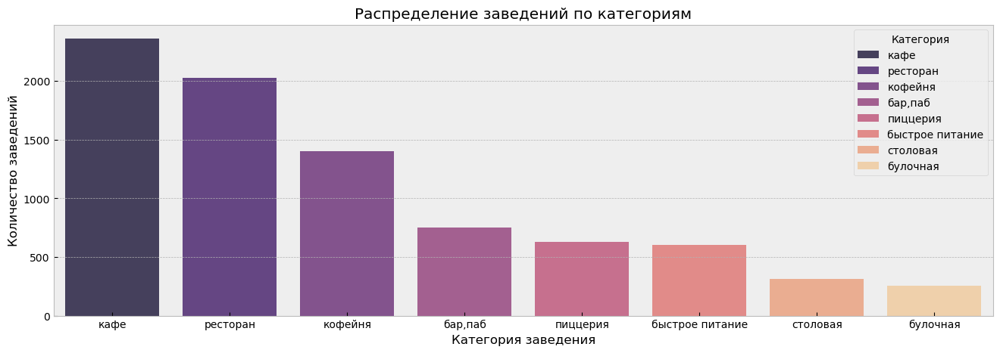

In [43]:
# построим столбчатую диаграмму распределения заведений по категориям
plt.figure(figsize=(16, 5))
ax = sns.barplot(data=cat_count, x="category", y="name", hue='category', palette='magma', alpha=.8, legend=True)
# for i in ax.containers:
#     ax.bar_label(i, size=10, weight="bold", color='white', padding=-20)
ax.set_title('Распределение заведений по категориям')
ax.set_xlabel('Категория заведения')
ax.set_ylabel('Количество заведений')
plt.legend(title='Категория')
plt.show()

***По данным на лето 2022 года самые многочисленные заведения Москвы это кафе (2363 объектов) и рестораны (2030 объектов), наименее представлены столовые (313 объектов) и булочные (255 объектов).***

### Подсчет количества посадочных мест заведений по категориям

- Исследуйте количество посадочных мест в местах по категориям: рестораны, кофейни, пиццерии, бары и так далее.
- Постройте визуализации.
- Проанализируйте результаты и сделайте выводы.

In [44]:
# еще раз выведем описательную статистику по столбцу с количеством мест
data['seats'].describe()

count    4736.000000
mean      100.044764
std        92.091535
min         0.000000
25%        40.000000
50%        72.000000
75%       130.000000
max       500.000000
Name: seats, dtype: float64

***Да, как мы ранее видели, смущает минимальное нулевое значение количества посадочных мест, даже в маленьких кофейнях есть 1-2 места как правило. Поэтому посчитаем значения, исключив заведения с 0 мест.*** 

In [45]:
# сгруппируем данные по среднему значению мест
seats_mean = data[data['seats'] != 0].groupby('category').agg({'seats':'mean'}) \
    .sort_values(by='seats', ascending=False).reset_index()
seats_mean

,category,seats
0,ресторан,116.762328
1,"бар,паб",109.911700
2,кофейня,103.804196
3,быстрое питание,101.433333
4,кафе,92.811907
5,булочная,92.676471
6,столовая,92.573248
7,пиццерия,90.041162


In [46]:
# сгруппируем данные по медианному значению мест
seats_median = data[data['seats'] != 0].groupby('category').agg({'seats':'median'}) \
    .sort_values(by='seats', ascending=False).reset_index()
seats_median

,category,seats
0,ресторан,87.0
1,"бар,паб",80.0
2,кофейня,80.0
3,столовая,76.0
4,быстрое питание,75.0
5,кафе,60.0
6,пиццерия,55.0
7,булочная,51.0


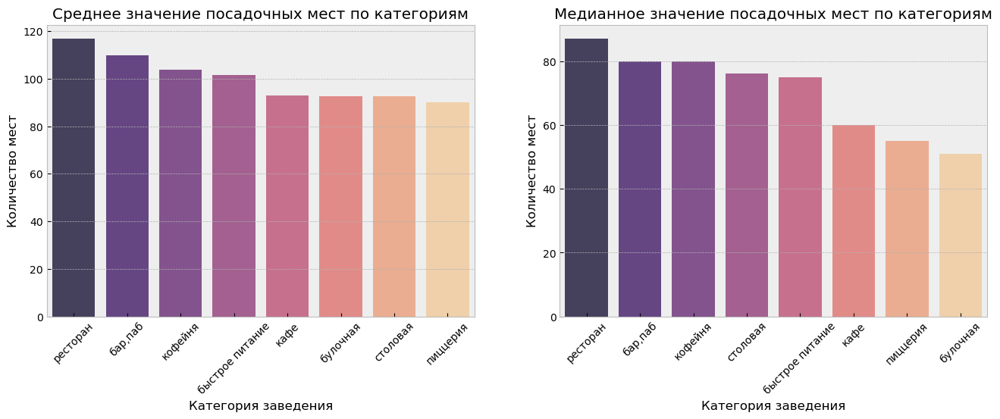

In [47]:
# теперь построим визуализации значений мест по категориям
plt.figure(figsize=(16, 5))

plt.subplot(121)
ax = sns.barplot(x='category', y='seats', data=seats_mean, palette='magma', alpha=.8, hue='category')
ax.set_title('Среднее значение посадочных мест по категориям')
ax.set_xlabel('Категория заведения')
ax.set_ylabel('Количество мест')
plt.xticks(rotation=45)

plt.subplot(122)
ax = sns.barplot(x='category', y='seats', data=seats_median, palette='magma', alpha=.8, hue='category')
ax.set_title('Медианное значение посадочных мест по категориям')
ax.set_xlabel('Категория заведения')
ax.set_ylabel('Количество мест')
plt.xticks(rotation=45)
plt.show()

***Судя и по средним и медианным значениям посадочных мест выигрывают рестораны, видимо данные заведения пользуются популярностью при проведении событий с участием большого количества людей, например, различных корпоративов и т.д. Чуть меньше по посадочным местам в барах/ пабах и кофейнях.***

***Кстати, что интересно, в моем представлении чаще кофейня - это небольшое уютное заведение с меньшим количеством мест, а вот кафе - заведение чуть больше, в котором тоже проводят многолюдные праздники, но видимо по московским меркам все наоборот, и кафейни находятся в топ-3 по количеству мест.***

### Изучение сетевых и несетевых заведений в датасете

- Рассмотрите и изобразите соотношение сетевых и несетевых заведений в датасете. Каких заведений больше?
- Какие категории заведений чаще являются сетевыми? Исследуйте данные и ответьте на вопрос графиком.

In [48]:
# посмотрим, каких заведений в данных больше
chain = data['chain'].value_counts() \
    .rename(index={0:'несетевые', 1:'сетевые'}) \
    .reset_index()
chain

,chain,count
0,несетевые,5170
1,сетевые,3177


In [49]:
# визуализируем соотношение сетевых и несетевых заведений в данных
fig = go.Figure()
# зададим данные и цвета для кусков пирога диаграммы
fig.add_trace(go.Pie(labels=chain['chain'], values=chain['count'], texttemplate='%{percent:.2p}',
                      marker_colors = ['#F6B17A', '#720455'], opacity = 0.8))
fig.update_layout(title='Соотношение сетевых и несетевых заведений', legend_title='Тип заведения',\
                      legend=dict(x=0.8))
# отобразим график
fig.show()

***В выборке по данным на лето 2022 по г. Москва представлено больше несетевых заведений (5170 или 62 %), чем сетевых (3177 или 38 %).*** 

In [50]:
# посчитаем долю сетевых заведений по категориям
chain_cat = data.groupby('category').agg({'chain': 'mean'}) \
    .sort_values(by='chain', ascending=False).reset_index()
chain_cat       

,category,chain
0,булочная,0.611765
1,пиццерия,0.521463
2,кофейня,0.508922
3,быстрое питание,0.383721
4,ресторан,0.355172
5,кафе,0.327550
6,столовая,0.277955
7,"бар,паб",0.221485


In [51]:
# построим столбчатый график распределения сетей заведений по категориям
fig = go.Figure()

fig.add_trace(go.Bar(x=chain_cat.category, y=chain_cat.chain, marker_color = '#720455', \
                     opacity = .7, name='Сетевые', text=chain_cat['chain']))

fig.update_layout(title='Доля сетевых заведений от общего количества по категориям', title_x=.5, \
                  xaxis_title='Категория заведения', yaxis_title='Доля заведений', legend=dict(y=0.95, x=0.84))
fig.update_traces(texttemplate='%{text:.1%}', textposition='inside')
fig.show()

***Как мы видели, несетевых заведений в датасете представлено больше, чем сетевых. Однако есть несколько категорий объектов, для которых сетевых заведений больше, судя по графику - это булочные (61,2 %), пиццерии (52,1 %) и кофейни (50,9 %).***

***Все остальные категории в основном являются несетевыми.***

### Исследование 15 самых популярных сетей заведений в Москве

- Сгруппируйте данные по названиям заведений и найдите топ-15 популярных сетей в Москве. Постройте подходящую для такой информации визуализацию.
- Знакомы ли вам эти сети?
- Есть ли какой-то признак, который их объединяет?
- К какой категории заведений они относятся?

In [52]:
# сделаем сводную таблицу, сгруппировав 15 самых популярных сетей в Москве
top_15 = data[data['chain'] == 1].groupby(['name', 'category']).agg({'rating':'max','district':'count'}) \
    .sort_values(by = 'district', ascending = False) \
    .head(15).reset_index()
top_15

,name,category,rating,district
0,шоколадница,кофейня,4.9,117
1,домино'с пицца,пиццерия,4.4,76
2,додо пицца,пиццерия,4.7,74
3,one price coffee,кофейня,4.9,70
4,яндекс лавка,ресторан,4.5,68
5,cofix,кофейня,4.4,65
6,prime,ресторан,4.3,49
7,кофепорт,кофейня,4.4,42
8,кулинарная лавка братьев караваевых,кафе,4.5,38
9,теремок,ресторан,4.6,36


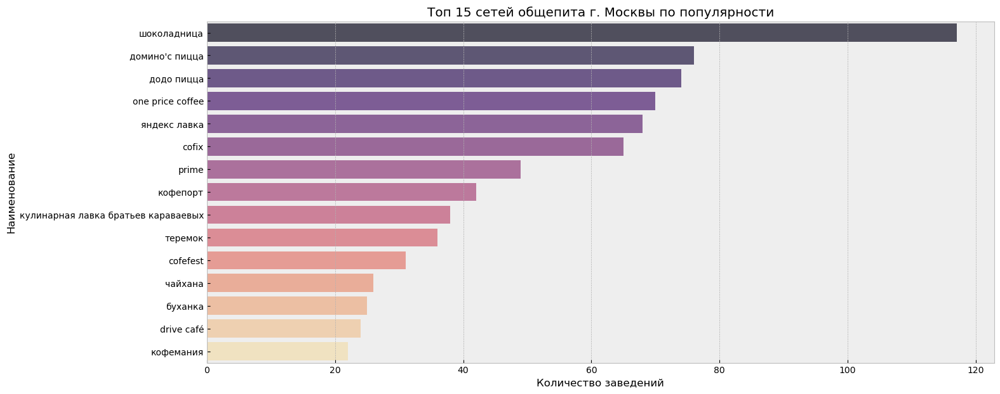

In [53]:
# построим барчат для 15 самых популярных сетей Москвы
plt.figure(figsize=(16, 7))
ax = sns.barplot(x='district', y='name', hue='name', data=top_15, palette='magma', alpha=.7, orient='h')

ax.set_title('Топ 15 сетей общепита г. Москвы по популярности')
ax.set_xlabel('Количество заведений')
ax.set_ylabel('Наименование')
plt.show()

***Получается, наиболее популярная и массово представленная сеть - это Шоколадница (117 объектов в разных районах города). Также достаточно популярны пиццерии Домино'с Пицца и Додо Пицца (76 и 74 объекта соответственно).***

***Данные заведения популярны не только в Москве - в нашем городе, Екатеринбурге, также данные заведения пользуются популярностью у народа, только представлены далеко не в таком количестве.***

***Что интересно, все эти заведения из топ-15 объединяет примерно одинаковый и достаточно высокий рейтинг у посетителей, не ниже 4,3 баллов.***

In [54]:
# построим интерактивную столбчатую диаграмму, чтобы посмотреть, к каким категориям относятся заведения
fig = px.bar(
            top_15,
            x='name',
            y='district',
            color='category',
            height=600,
            title='Топ-15 сетей Москвы по популярности',
            opacity=.6
)
fig.update_layout(legend_title='Тип заведения', xaxis_title='Наименование', yaxis_title='Количество заведений', title_x=.5)
fig.show()

***Судя по графику, среди 15 наиболее популярных сетей Москвы самые частые категории - это кофейни, и уже на втором месте по популярности - это пиццерии. Самая малочисленная категория среди популярных сетевых заведений Москвы - это булочные.***

In [55]:
# посмотрим, в каких районах более всего популярных сетей из топ 15
district_chain = data[data['chain'] == 1].groupby(['name', 'district']).agg({'rating':'max','address':'count'}) \
    .sort_values(by = 'address', ascending = False).reset_index()
district_chain = district_chain[district_chain['name'].isin(top_15['name'])]
district_chain.head(15)

,name,district,rating,address
0,шоколадница,Центральный административный округ,4.3,38
1,prime,Центральный административный округ,4.3,37
2,кулинарная лавка братьев караваевых,Центральный административный округ,4.5,32
3,cofix,Центральный административный округ,4.4,20
4,шоколадница,Западный административный округ,4.3,16
5,кофемания,Центральный административный округ,4.5,15
7,one price coffee,Центральный административный округ,4.9,15
8,кофепорт,Центральный административный округ,4.4,15
10,шоколадница,Северный административный округ,4.3,14
12,яндекс лавка,Южный административный округ,4.3,12


***Больше всего популярных заведений из топ-15 представлено в Центральном административном округе Москвы (в общей сложности 170 штук - из них 38 объектов "Шоколадницы" - наиболее популярной сети).***

In [56]:
# посмотрим долю категорий в топ 15 популярных сетей
t15_cat = top_15.groupby('category', as_index=False).agg({'district':'sum'}).sort_values(by='district', ascending=False)
t15_cat['part'] = t15_cat['district'] / top_15['district'].sum()
t15_cat

,category,district,part
2,кофейня,347,0.454784
4,ресторан,153,0.200524
3,пиццерия,150,0.196592
1,кафе,88,0.115334
0,булочная,25,0.032765


In [57]:
# построим график долей категорий в топ 15 популярных сетей
fig = go.Figure()

fig.add_trace(go.Bar(x=t15_cat.category, y=t15_cat.district, marker_color = '#720455', \
                     opacity = .7, name='Сетевые', text=t15_cat['part']))

fig.update_layout(title='Доля сетевых заведений от общего количества по категориям', title_x=.5, \
                  xaxis_title='Категория заведения', yaxis_title='Доля заведений', legend=dict(y=0.95, x=0.84))
fig.update_traces(texttemplate='%{text:.1%}', textposition='inside')
fig.show()

***Самая распространенная категория из топ 15 заведений - это конечно кофейни, почти половина от общего количества (45,4 %), а самая редкая - это булочные (всего 3,3 %). Также можно обратить внимание, что в категории популярных сетей из топ 15 не вошли совсем такие категории, как бары/ пабы, заведения быстрого питания и столовые.***

In [58]:
# check
x = data.copy()
df_chain = x[x['chain'] == 1]
 
(
    df_chain
    .groupby(['name', 'category']).agg(count_name=('name', 'count')).sort_values(by='count_name').tail(15)
    .reset_index()
    .groupby('category')['count_name'].sum()
    .to_frame()
    .assign(percent_total=lambda x: x / x.sum()).round(2)
    .sort_values(by='percent_total')
)

,count_name,percent_total
category,,
булочная,25,0.03
кафе,88,0.12
пиццерия,150,0.20
ресторан,153,0.20
кофейня,347,0.45


### Изучение объектов общественного питания Москвы в распределении по районам

- Какие административные районы Москвы присутствуют в датасете?

Отобразите общее количество заведений и количество заведений каждой категории по районам. Попробуйте проиллюстрировать эту информацию одним графиком.

In [59]:
# посмотрим, какие районы представлены в датасете
data['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

In [60]:
# посмотрим, сколько заведений представлено в каждом административном округе
data.groupby('district').agg({'address':'count'}) \
    .sort_values(by = 'address', ascending = False).reset_index()

,district,address
0,Центральный административный округ,2242
1,Южный административный округ,891
2,Северо-Восточный административный округ,890
3,Северный административный округ,876
4,Западный административный округ,830
5,Восточный административный округ,789
6,Юго-Восточный административный округ,714
7,Юго-Западный административный округ,706
8,Северо-Западный административный округ,409


In [61]:
# отобразим на графике количество заведений каждой категории по округам
fig = px.histogram(
            data,
            y='district',
            color='category',
            title='Распределение категорий заведений по административным округам',
            opacity=.6
)
fig.update_layout(legend_title='Категория',
                  xaxis_title='Количество заведений',
                  yaxis_title='Наименование округа',
                  title_x=.5, yaxis={'categoryorder':'total ascending'})
fig.show()

In [62]:
# отобразим на графике количество заведений каждой категории по округам в относительных величинах
fig = px.histogram(
            data,
            y='district',
            color='category',
            title='Распределение категорий заведений по административным округам',
            opacity=.6,
            barmode='stack',
            barnorm='percent'
)
fig.update_layout(legend_title='Категория',
                  xaxis_title='Количество заведений',
                  yaxis_title='Наименование округа',
                  title_x=.5, yaxis={'categoryorder':'total ascending'})

fig.show()

***Логично, что больше всего заведений независимо от категории представлено в Центральном административном округе (2242 объекта), по категориям там преобладают рестораны, и чуть меньше кафе и кофейни.***

***Во всех остальных округах примерно одинаково по общему количеству заведений общепита (700-900 заведений), кроме Северо-Западного административного округа, он достаточно сильно отстает (409 заведений).***

***В основном по категориям во всех округах больше всего действует кафе и ресторанов, в некоторых округах кофейни почти не отстают от кафе.***

### Распределение средних рейтингов по категориям заведений

Визуализируйте распределение средних рейтингов по категориям заведений. Сильно ли различаются усреднённые рейтинги в разных типах общепита?

In [63]:
# сгруппируем усредненные значения рейтингов по категориям
avg_rating = data.groupby('category')['rating'].agg(['mean', 'median']) \
    .sort_values(by = 'mean', ascending=False).reset_index()
avg_rating

,category,mean,median
0,"бар,паб",4.390186,4.4
1,пиццерия,4.300636,4.3
2,ресторан,4.289852,4.3
3,кофейня,4.277373,4.3
4,булочная,4.267843,4.3
5,столовая,4.211821,4.3
6,кафе,4.123953,4.2
7,быстрое питание,4.049834,4.2


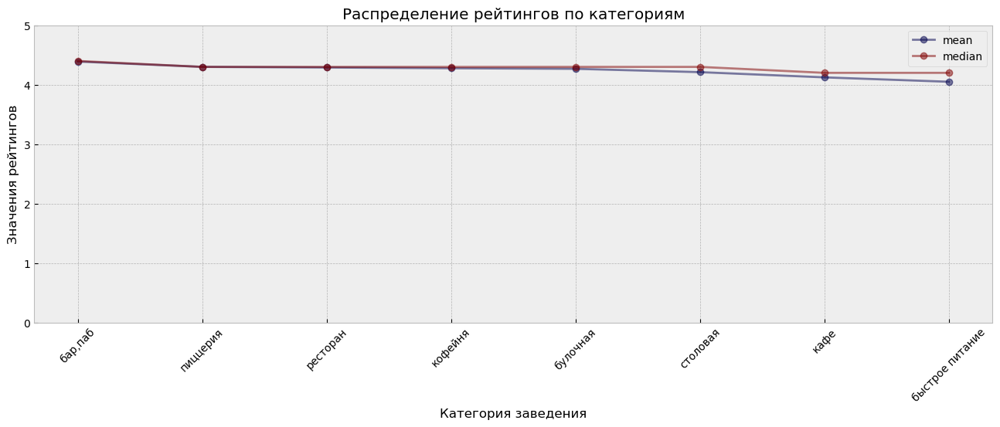

In [64]:
# сделаем визуализацию рейтингов по категориям с помощью простого линейного графика
avg_rating.plot(style='-o',
                grid=True,
                figsize=(16, 5),
                alpha=0.5,
                x='category',
                title='Распределение рейтингов по категориям',
                xlabel='Категория заведения',
                ylabel='Значения рейтингов',
                cmap='seismic',
                ylim=(0, 5)
               )
plt.xticks(rotation=45)
plt.show()

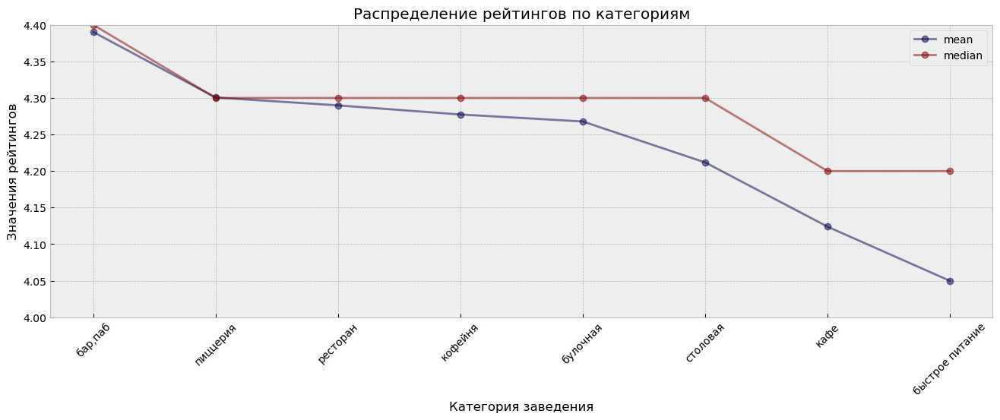

In [65]:
# возьмем полный диапазон значений рейтингов по оси y
avg_rating.plot(style='-o',
                grid=True,
                figsize=(16, 5),
                alpha=0.5,
                x='category',
                title='Распределение рейтингов по категориям',
                xlabel='Категория заведения',
                ylabel='Значения рейтингов',
                cmap='seismic',
                ylim=(4, 4.4)
               )
plt.xticks(rotation=45)
plt.show()

***Как мы увидели, усредненные значения рейтингов сильно не различаются в зависимости от категории, но все же не можем не обратить внимание, что хуже всего обстоит ситуация у предприятий быстрого питания. И что достаточно неочевидно, выше всего средний рейтинг у баров, пабов и пиццерий.***

***Можем еще посмотреть, какое количество заведений в каждой категории имеют самый высокий рейтинг.***

In [66]:
# посмотрим, сколько заведений в каждой категории имеют самый высокий рейтинг
df = data[data['rating'] == 5.0].groupby('category')['rating'].agg('count').reset_index() \
    .sort_values(by='rating', ascending=False)
df

,category,rating
4,кофейня,37
3,кафе,30
6,ресторан,15
0,"бар,паб",7
5,пиццерия,7
2,быстрое питание,6
7,столовая,2
1,булочная,1


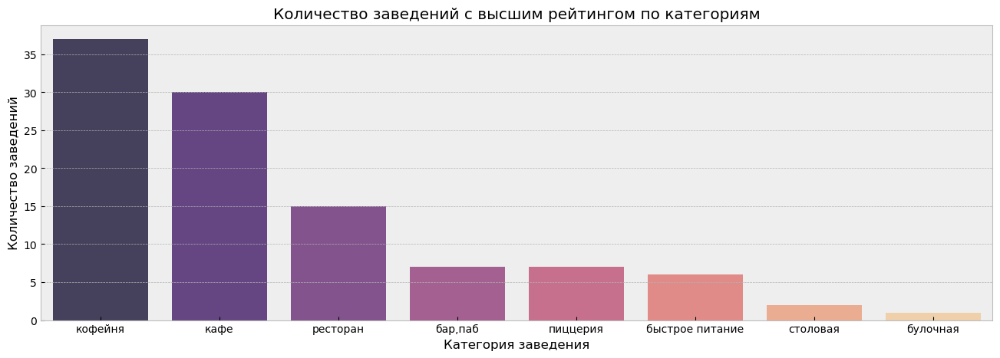

In [67]:
# сделаем визуализацию количества заведений с высшим рейтингом в разделении по категориям
plt.figure(figsize=(16, 5))

ax = sns.barplot(x='category', y='rating', data=df, palette='magma', alpha=.8, hue='category') 

ax.set_title('Количество заведений с высшим рейтингом по категориям')
ax.set_xlabel('Категория заведения')
ax.set_ylabel('Количество заведений')

plt.show()

***Да, количество заведений с высшим рейтингом в разных категориях разное, однако это не следствие того, что есть зависимость рейтинга заведения от категории. Рейтинг составляется на основе вкуса и качества кухни, качества обслуживания, чистоты, скорости обслуживания и других факторов. Хотя есть мнение, что когда люди приходят в ресторан, они ждут более качественного обслуживания, чем в той же кофейне. Поэтому более придирчиво все оценивают, и выставляют рейтинг.***

***Разница в количестве объясняется тем, что общее количество представленных в датасете кофеен в принципе гораздо больше, чем представленных в датасете столовых и булочных, что мы выяснили еще в п. 3.2. Ну и также возможно то, что в кофейнях, кафе и ресторанах владельцы более пристально следят за соблюдением стандартов качества и других норм.***

### Построение фоновой картограммы (хороплета) со средним рейтингом заведений каждого района

Постройте фоновую картограмму (хороплет) со средним рейтингом заведений каждого района. Границы районов Москвы, которые встречаются в датасете, хранятся в файле `admin_level_geomap.geojson`.

In [68]:
# для каждого округа посчитаем средний рейтинг заведений, которые находятся на его территории
rating_df = round(data.groupby('district')['rating'].agg('mean'), 2).reset_index()
rating_df

,district,rating
0,Восточный административный округ,4.17
1,Западный административный округ,4.18
2,Северный административный округ,4.24
3,Северо-Восточный административный округ,4.15
4,Северо-Западный административный округ,4.21
5,Центральный административный округ,4.38
6,Юго-Восточный административный округ,4.10
7,Юго-Западный административный округ,4.17
8,Южный административный округ,4.18


In [69]:
# загружаем JSON-файл с границами округов Москвы и сохраним в переменную

try:
    geo = json.load(codecs.open('C:/Users/etols/Downloads/admin_level_geomap.geojson', 'r', 'utf-8-sig'))
except:
    geo = '/datasets/admin_level_geomap.geojson'

# создаём карту Москвы
m = Map(location=[55.751244, 37.618423], zoom_start=10, tiles='Cartodb Positron')

# создаём хороплет с помощью конструктора Choropleth, добавим интерактивные подписи названий округов
Choropleth(
    geo_data=geo,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.properties.name',
    fill_color='OrRd',
    fill_opacity=.8,
    legend_name='Средний рейтинг заведений в разбивке по округам',
).add_to(m).geojson.add_child(folium.features.GeoJsonTooltip(['name',], labels=False))


# выводим карту
m

***Что еще интересно, в Центральном административном округе не только больше всего заведений представлено, но также там и самый высокий средний рейтинг заведений (4.38 балла). Конечно, центр столицы - нужно поддерживать имидж! :)***

***Чуть меньше рейтинг у заведений Северного и Северо-Западного административного округов (4.24 балла и 4.21 балл соответственно).***

***Самый низкий средний рейтинг у объектов, которые находятся в Юго-Восточном административном округе.***

Отобразите все заведения датасета на карте с помощью кластеров средствами библиотеки `folium`.

In [70]:
# создаём карту Москвы
m = Map(location=[55.751244, 37.618423], zoom_start=10, tiles="Cartodb Positron")
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
data.apply(create_clusters, axis=1)

# выводим карту
m

***Здесь также на карте видим, что подавляющее большинство заведений сосредоточено в центре города Москвы.***

### Исследование улиц по количеству заведений

- Найдите топ-15 улиц по количеству заведений.
- Постройте график распределения количества заведений и их категорий по этим улицам. Попробуйте проиллюстрировать эту информацию одним графиком.

In [71]:
# найдем топ-15 улиц по количеству заведений общественного питания
street_top_15 = data.pivot_table(index='street', values='name', aggfunc='count') \
    .sort_values(by='name', ascending=False).reset_index().head(15)
street_top_15

,street,name
0,проспект Мира,183
1,Профсоюзная улица,122
2,Ленинский проспект,107
3,проспект Вернадского,97
4,Дмитровское шоссе,88
5,Каширское шоссе,77
6,Варшавское шоссе,76
7,Ленинградский проспект,72
8,Ленинградское шоссе,70
9,МКАД,65


In [72]:
# отобразим визуализацию на интерактивном барплоте
fig = px.bar(
            street_top_15,
            x='name',
            y='street',
            color='street',
            height=600,
            title='Топ-15 улиц Москвы по количеству заведений',
            opacity=.8
)
fig.update_layout(legend_title='Улица',
                  xaxis_title='Наименование улицы',
                  yaxis_title='Количество заведений',
                  title_x=.5)
fig.show()

***Как мы видим, больше всего объектов общественного питания сосредоточено на проспекте Мира, который расположен в Центральном административном округе (где и заведений больше всего в принципе).  Можно было бы подумать, что больше всего заведений на проспекте Мира расположено потому что это самая длинная улица, однако проспект Мира длиной 9 км, а вот улица на втором месте Профсоюзная считается самой длинной в г. Москва - 14 км.***

***Скорее всего проспект Мира выигрывает не столько за счет длины, сколько за счет того, что улица находится в самом центре, соответственно проходимость больше.***

***Посмотрим, как обстоит дело в распределении по категориям заведений.***

In [73]:
# сгруппируем данные в разрезе по категориям заведений
street_cat = data.groupby(['street', 'category'], as_index=False) \
    .agg({'name':'count'}).sort_values(by='name', ascending=False)
street_cat

,street,category,name
2859,проспект Мира,кафе,53
1379,МКАД,кафе,45
2862,проспект Мира,ресторан,45
2860,проспект Мира,кофейня,36
1988,Профсоюзная улица,кафе,35
...,...,...,...
1530,Моховая улица,"бар,паб",1
1532,Мукомольный проезд,булочная,1
1533,Мукомольный проезд,быстрое питание,1
1534,Мукомольный проезд,пиццерия,1


In [74]:
# соотнесем сгрппированные выше данные с улицами из топ-15
top_15_cat = street_cat[street_cat['street'].isin(street_top_15['street'])]
top_15_cat

,street,category,name
2859,проспект Мира,кафе,53
1379,МКАД,кафе,45
2862,проспект Мира,ресторан,45
2860,проспект Мира,кофейня,36
1988,Профсоюзная улица,кафе,35
...,...,...,...
2842,проспект Вернадского,булочная,1
1364,Люблинская улица,пиццерия,1
1377,МКАД,"бар,паб",1
1382,МКАД,столовая,1


In [75]:
# представим данные на интерактивном графике
fig = px.bar(top_15_cat, 
             x='name', 
             y='street',                    
             color='category',
             opacity=.7
            )

fig.update_layout(title='Количество заведений каждой категории в разрезе по улицам из топ-15',
                  legend_title='Категория',
                  xaxis_title='Количество заведений',
                  yaxis_title='Название улицы',
                  yaxis={'categoryorder':'total ascending'},
                  title_x=.5
                 )
fig.show()

***Как мы видим, на двух самых плотных по количеству заведений улицах из топ-15 преобладают кафе, рестораны и кофейни (на проспекте Мира - 53 кафе, 45 ресторанов, 36 кофеен, на Профсоюзной улице схожая ситуация - 35 кафе, 26 ресторанов, 18 кофеен).***

Найдите улицы, на которых находится только один объект общепита. Что можно сказать об этих заведениях?

In [76]:
# найдем улицы, на которых находится только один объект общепита
one_obj_street = data.groupby('street', as_index=False)['name'].count()
one_obj_street = one_obj_street.loc[one_obj_street.name == 1, 'street']
map_one_obj_street = data.query("street in @one_obj_street")

In [77]:
# посмотрим, в каких районах находятся улицы с одним объектом общепита
m = Map(location=[55.751244, 37.618423], zoom_start=10, tiles="Cartodb Positron")
marker_cluster = MarkerCluster().add_to(m)


def create_clusters(row):
    Marker([row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)
    
    
map_one_obj_street.apply(create_clusters, axis=1)
m

***Да, как и ожидалось, подавляющее большинство таких заведений в Центральном АО, и в принципе, в центре. Однако некоторое количество имеется и на окраинах.*** 

In [78]:
# посмотрим, к каким категориям относятся эти заведения и посчитаем их количество
one_obj_cat = street_cat[street_cat['street'].isin(one_obj_street)]
one_obj_bar = one_obj_cat.groupby('category')['street'].agg('count')
one_obj_bar.sort_values(ascending=False)

category
кафе               160
ресторан            93
кофейня             84
бар,паб             39
столовая            36
быстрое питание     23
пиццерия            15
булочная             8
Name: street, dtype: int64

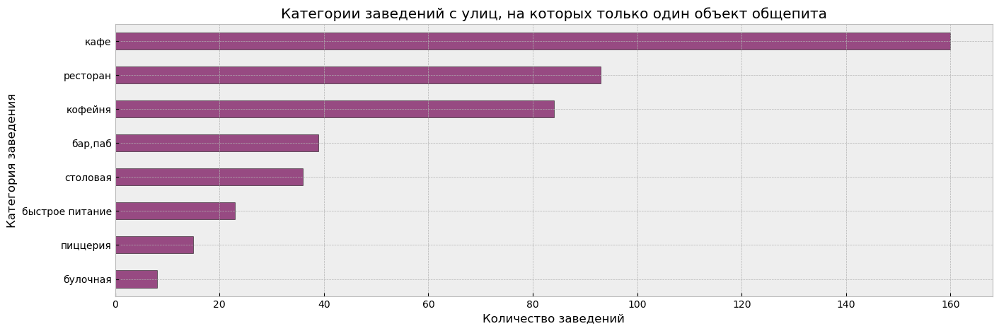

In [79]:
# построим визуализацию категорий таких заведений
one_obj_bar.sort_values().plot(kind='barh',
          grid=True,
          figsize=(16, 5),
          edgecolor = 'black',
          title='Категории заведений с улиц, на которых только один объект общепита',
          color='#720455',
          xlabel='Количество заведений',
          ylabel='Категория заведения',
          alpha=.7)
plt.show()

***Всего в датасете представлено 458 улиц, на которых только один объект общественного питания. Если распределить все эти заведения по категориям, то больше всего заведений находится в категории кафе (160), чуть меньше таких заведений в категории ресторан (93). И менее всего в категории булочная (всего 8).***

***Хотя кафе и ресторанов в принципе в датасете представлено больше всего, а булочных меньше всего.***

### Исследование значений цен и средних чеков заведений

- Значения средних чеков заведений хранятся в столбце `middle_avg_bill`. Эти числа показывают примерную стоимость заказа в рублях, которая чаще всего выражена диапазоном. Посчитайте медиану этого столбца для каждого района.
- Используйте это значение в качестве ценового индикатора района. Постройте фоновую картограмму (хороплет) с полученными значениями для каждого района. Проанализируйте цены в центральном административном округе и других. Как удалённость от центра влияет на цены в заведениях?

In [80]:
# посмотрим медианное значение среднего чека для каждого района
median_bill = data.groupby('district')['middle_avg_bill'].agg('median').reset_index()\
    .sort_values(by='middle_avg_bill', ascending=False)
median_bill

,district,middle_avg_bill
1,Западный административный округ,1000.0
5,Центральный административный округ,1000.0
4,Северо-Западный административный округ,700.0
2,Северный административный округ,650.0
7,Юго-Западный административный округ,600.0
0,Восточный административный округ,550.0
3,Северо-Восточный административный округ,500.0
8,Южный административный округ,500.0
6,Юго-Восточный административный округ,450.0


In [81]:
# создаём карту Москвы
m = Map(location=[55.751244, 37.618423], zoom_start=10, tiles='Cartodb Positron')

# создаём хороплет с помощью конструктора Choropleth, добавим интерактивные подписи названий округов
Choropleth(
    geo_data=geo,
    data=median_bill,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.properties.name',
    fill_color='OrRd',
    fill_opacity=.7,
    legend_name='Медианное значение средних чеков заведений в разбивке по округам',
).add_to(m).geojson.add_child(folium.features.GeoJsonTooltip(['name',], labels=False))

# выводим карту
m

***Самые высокие медианные значения средних чеков заведений в Центральном и Западном административных округах (1000 руб.), а самое низкое значение - в Юго-Восточном административном округе (450 руб.)***

***В остальных округах значения колеблются от 500 до 700 рублей, значит удаленность от Центрального административного округа влияет на цены в заведениях по-разному, не везде чем удаленнее, тем дешевле.***

***Стоит отметить, что в разрезе по категориям в Центральном административном округе ресторанов и баров/ пабов больше, чем во всех остальных округах, что тоже может влиять на средние чеки. Однако даже если сранивать значения во всех остальных округах (не учитывая ЦАО), количество ресторанов и пабов в них примерно одинаковое, но в Западном административном округе тем не менее сохраняется самое высокое медианное значение среднего чека.***

### Исследование других взаимосвязей в данных

Необязательное задание: проиллюстрируйте другие взаимосвязи, которые вы нашли в данных.
- Например, по желанию исследуйте часы работы заведений и их зависимость от расположения и категории заведения.
- Также можно исследовать особенности заведений с плохими рейтингами, средние чеки в таких местах и распределение по категориям заведений.

In [82]:
# возьмем строки только с теми заведениями, которые работают 24 на 7
df_24_7 = data[data['is_24_7'] == True].copy()

In [83]:
# посчитаем, сколько в каждом округе заведений, работающих 24 на 7
distr_24_7 = df_24_7.groupby('district') \
    .agg({'name':'count'}).sort_values(by='name', ascending=False).reset_index()
distr_24_7

,district,name
0,Центральный административный округ,131
1,Восточный административный округ,97
2,Юго-Восточный административный округ,93
3,Северо-Восточный административный округ,75
4,Южный административный округ,75
5,Юго-Западный административный округ,73
6,Западный административный округ,70
7,Северный административный округ,70
8,Северо-Западный административный округ,43


In [84]:
# создаём карту Москвы
m = Map(location=[55.751244, 37.618423], zoom_start=10, tiles='Cartodb Positron')

# создаём хороплет с помощью конструктора Choropleth, добавим интерактивные подписи названий округов
Choropleth(
    geo_data=geo,
    data=distr_24_7,
    columns=['district', 'name'],
    key_on='feature.properties.name',
    fill_color='OrRd',
    fill_opacity=.8,
    legend_name='Количество заведений 24 на 7 в разбивке по округам',
).add_to(m).geojson.add_child(folium.features.GeoJsonTooltip(['name',], labels=False))

# выводим карту
m

***Что логично, больше всего круглосуточных и работающих 7 дней в неделю заведений находится в центре Москвы, конечно, ведь в центре города люди часто гуляют по выходным и круглосуточно.***

***Посмотрим теперь, каких категорий среди таких заведений больше.***

In [85]:
# посчитаем, в каких категориях представлены заведения, работающие 24 на 7
cat_24_7 = df_24_7.groupby('category') \
    .agg({'name':'count'}).sort_values(by='name', ascending=False).reset_index()
cat_24_7['part'] = cat_24_7['name'] / cat_count['name']
cat_24_7

,category,name,part
0,кафе,266,0.112569
1,быстрое питание,150,0.073892
2,ресторан,133,0.094932
3,кофейня,59,0.078249
4,"бар,паб",52,0.082671
5,пиццерия,31,0.051495
6,булочная,24,0.076677
7,столовая,12,0.047059


In [86]:
# представим данные на интерактивном графике
fig = go.Figure()

fig.add_trace(go.Bar(x=cat_24_7.category, y=cat_24_7.name, marker_color = '#720455', \
                     opacity = .7, text=cat_24_7['part']))

fig.update_layout(title='Доля заведений, работающих 24 на 7, в разбивке по категориям', title_x=.5, \
                  xaxis_title='Категория заведения', yaxis_title='Количество заведений', legend=dict(y=0.95, x=0.84))
fig.update_traces(texttemplate='%{text:.1%}', textposition='inside')
fig.show()

***Больше всего среди заведений 24 на 7 представлено кафе (266 или 11,3 % от общего количества всех заведений данной категории), на втором и третьем местах с незначительным отрывом друг от друга соответственно идут заведения быстрого питания и рестораны (150 или 7,4 % и 133 или 9,5 %).***

***Что неожиданно, среди круглосуточных заведений встретились и булочные со столовыми, видимо в таком городе, как Москва, есть на это спрос.***

***Исследуем особенности заведений в зависимости от рейтинга.***

In [87]:
# добавим столбец с типом рейтинга (значения — «высокий», «низкий») с помощью функции
def rating_type(row):
    if row['rating'] > 3:
        return 'высокий'
    else:
        return 'низкий'
data['rating_type'] = data.apply(rating_type, axis=1)

In [88]:
# посмотрим, сколько каких категорий заведений с низким рейтингом и добавим значения среднего чека
rating_avg_bill = data.groupby(['category', 'rating_type'])['middle_avg_bill'].median() \
    .reset_index().sort_values(by='middle_avg_bill', ascending=False)
rating_avg_bill

,category,rating_type,middle_avg_bill
0,"бар,паб",высокий,1250.0
12,ресторан,высокий,1250.0
11,пиццерия,низкий,900.0
7,кафе,низкий,750.0
10,пиццерия,высокий,600.0
6,кафе,высокий,537.5
2,булочная,высокий,475.0
8,кофейня,высокий,400.0
4,быстрое питание,высокий,375.0
3,булочная,низкий,325.0


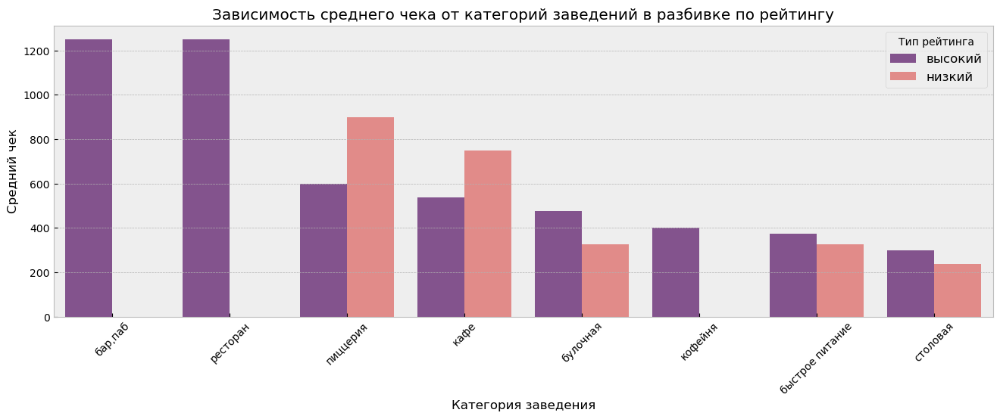

In [89]:
# посмотрим данные на графике
plt.figure(figsize=(16, 5))

ax = sns.barplot(x='category',
                 y='middle_avg_bill', 
                 hue='rating_type', 
                 data=rating_avg_bill, 
                 palette='magma', 
                 alpha=.8              
                )

ax.set_title('Зависимость среднего чека от категорий заведений в разбивке по рейтингу')
ax.set_xlabel('Категория заведения')
ax.set_ylabel('Средний чек')
plt.xticks(rotation=45)
plt.legend(title='Тип рейтинга', loc='upper right', fontsize=12)
plt.show()

***Практически во всех категориях заведений чем выше рейтинг заведения, тем выше средний чек, кроме двух категорий - кафе и пиицерий. А в ресторанах и пабах либо нет заполненных данных по рейтингу заведения, либо просто так получилось, что в данной выборке в определенный период времени все заведения держат уровень рейтинга выше 3 баллов.***

In [90]:
# создадим отдельную табличку с долей заведений с низким рейтингом от общего количества
low = data[data['rating_type'] == 'низкий'].groupby('category', as_index=False)['name'].count()
# объединим нашу табличку с ранее созданной, с количеством объектов по категориям
low_part = cat_count.merge(low, how='left', on='category')
low_part['share'] = low_part['name_y'] / low_part['name_x']

low_part.sort_values(by='name_y', ascending=False)

,category,name_x,name_y,share
0,кафе,2363,118,0.049937
1,ресторан,2030,37,0.018227
5,быстрое питание,602,35,0.058140
2,кофейня,1401,18,0.012848
4,пиццерия,629,9,0.014308
3,"бар,паб",754,8,0.010610
6,столовая,313,7,0.022364
7,булочная,255,2,0.007843


In [91]:
# построим столбчатый график долей заведений с низким рейтингом
fig = go.Figure()

fig.add_trace(go.Bar(x=low_part.category, y=low_part.share, marker_color = '#720455', opacity = .7, text=low_part['share']))

fig.update_layout(title='Доля заведений с низким рейтингом от общего количества объектов', title_x=.5, \
                  xaxis_title='Категория заведения', yaxis_title='Доля заведений', \
                  legend=dict(y=0.95, x=0.84), xaxis={'categoryorder':'total descending'})
fig.update_traces(texttemplate='%{text:.1%}', textposition='inside')
fig.show()

***Больше всего процент заведений с низким рейтингом среди объектов быстрого питания и кафе, ресторанов с низким рейтингом в подборке представлено почти больше всего по количеству, после кафе, но доля от общего количества ресторанов Москвы невелика.***

***Далее посмотрим на значения средних чеков в таких заведениях.***

In [92]:
# вспомним описательную статистику и обратим внимание на значения среднего чека
data['middle_avg_bill'].describe()

count     3131.000000
mean       956.103801
std       1010.722276
min          0.000000
25%        375.000000
50%        750.000000
75%       1250.000000
max      35000.000000
Name: middle_avg_bill, dtype: float64

***Судя по описательной статистике, очень сильно отличается среднее и медианное значение чека по заведениям, поэтому нужно посмотреть, не выбросы ли это.***

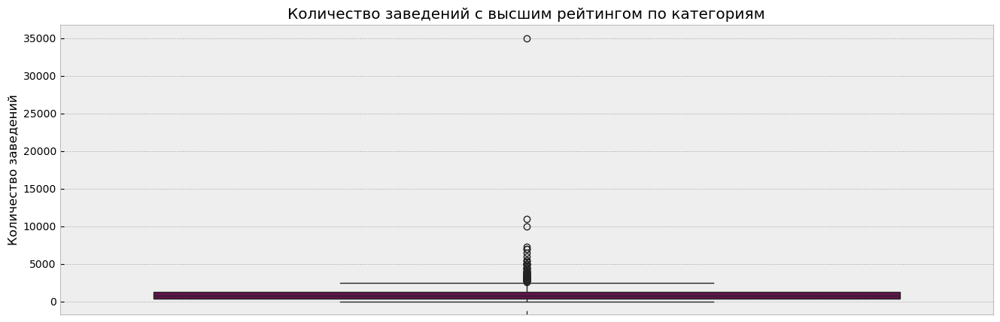

In [93]:
# посмотрим диаграмму размаха
plt.figure(figsize=(16, 5))

ax = sns.boxplot(y='middle_avg_bill', data=data, color='#720455')

ax.set_title('Количество заведений с высшим рейтингом по категориям')
ax.set_ylabel('Количество заведений')
plt.show()

***В пределах диапазона "нормального размаха" далее на графике оставим значения среднего чека не более 5000 руб. С такими значениями построим точечный график зависимости двух величин.***

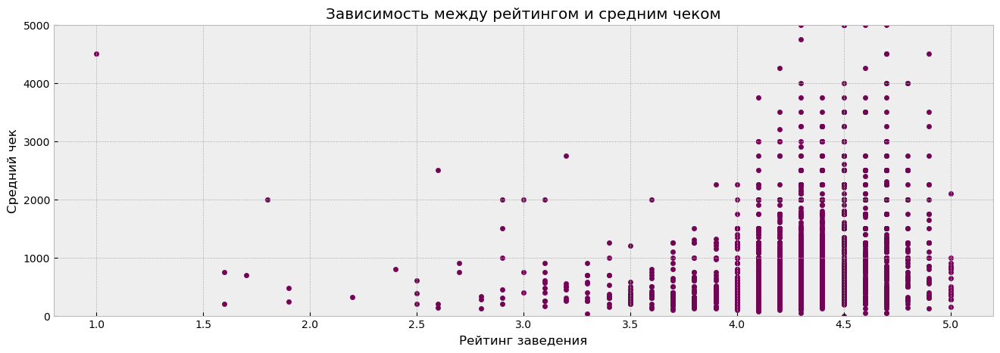

In [94]:
# посмотрим корреляцию между интересующими нас величинами
data.plot(x='rating',
          y='middle_avg_bill',
          kind='scatter', 
          color='#720455', 
          ylim=(0, 5000), 
          xlabel='Рейтинг заведения',
          ylabel='Средний чек',
          title='Зависимость между рейтингом и средним чеком',
          figsize=(16, 5)
         )

plt.show()

***По графику особой зависимости среднего чека от рейтинга заведения не выявлено. Больше всего заведений со значениями рейтингов больше 3,5 баллов, однако средний чек в таких заведениях ниже 2000 рублей, нет роста среднего чека с увеличением рейтинга.***

***ВЫВОДЫ:***

- Мы подсчитали количество заведений общепита по категориям и выяснили, что самые многочисленные заведения Москвы это кафе (2363 штук) и рестораны (2030 штук) и наименее представлены столовые (313 штук) и булочные (255 штук).

- Судя по средним и медианным значениям посадочных мест по категориям выигрывают рестораны, чуть меньше по посадочным местам в барах/ пабах и кофейнях.

- В нашей выборке по г. Москва представлено больше несетевых заведений (5170 или 62 %), чем сетевых (3177 или 38 %). Однако в разбивке по категориям есть несколько категорий объектов, для которых сетевых заведений больше - булочные (61,2 %), пиццерии (52,1 %) и кофейни (50,9 %).

- Мы исследовали 15 самый популярных сетей заведений в Москве, получилось, что наиболее популярная и массово представленная сеть - это Шоколадница (117 объектов в разных районах города). Также достаточно популярны пиццерии Домино'с Пицца и Додо Пицца (76 и 74 объекта соответственно). Также выяснили, что все эти заведения из топ-15 объединяет примерно одинаковый и достаточно высокий рейтинг у посетителей, не ниже 4,3 баллов.

- В ходе составленных визуализаций видно, что самая распространенная категория из топ 15 заведений - это конечно кофейни, почти половина от общего количества (45,4 %), а самая редкая - это булочные (всего 3,3 %). Также можно обратить внимание, что в категории популярных сетей из топ 15 не вошли совсем такие категории, как бары/ пабы, заведения быстрого питания и столовые.

- Больше всего популярных заведений из топ-15 представлено в Центральном административном округе Москвы (в общей сложности 170 штук - из них 38 объектов "Шоколадницы" - наиболее популярной сети).

- В распределении по округам мы посмотрели, что сильно больше  заведений независимо от категории представлено в Центральном административном округе (2242 объекта), по категориям там преобладают рестораны, и чуть меньше кафе и кофейни. На последнем месте Северо-Западный административный округ, он достаточно сильно отстает (409 заведений).

- В основном по категориям во всех округах больше всего действуют кафе и рестораны, в некоторых округах кофейни не отстают от кафе.

- Как мы увидели, усредненные значения рейтингов сильно не различаются в зависимости от категории, но все же не можем не обратить внимание, что хуже всего обстоит ситуация у предприятий быстрого питания. И значения среднего рейтинга выше всего у баров, пабов и пиццерий.

- Мы посмотрели распределение рейтингов по категориям заведений и выявили, что количество заведений с высшим рейтингом в разных категориях разное, однако это не следствие того, что есть зависимость рейтинга заведения от категории.

- По итогам построенной фоновой картограммы со средним рейтингом заведений каждого района можно увидеть, что в Центральном административном округе не только больше всего заведений представлено, но также там и самый высокий средний рейтинг заведений (4.38). Самый низкий средний рейтинг у объектов, которые находятся в Юго-Восточном административном округе.

- Мы составили топ-15 улиц по количеству заведений, соответственно больше всего объектов общественного питания сосредоточено на проспекте Мира, который расположен в Центральном административном округе (где и заведений больше всего в принципе). По категориям там преобладают кафе, рестораны и кофейни (на проспекте Мира - 53 кафе, 45 ресторанов, 36 кофеен).

- Как мы видим, больше всего объектов общественного питания сосредоточено на проспекте Мира, который расположен в Центральном административном округе (где и заведений больше всего в принципе). Скорее всего проспект Мира выигрывает не столько за счет длины, сколько за счет того, что улица находится в самом центре, соответственно проходимость больше.

- Всего в датасете представлено 458 улиц, на которых только один объект общественного питания. Если распределить все эти заведения по категориям, то больше всего заведений находится в категории кафе (160 объектов), чуть меньше таких заведений в категории ресторан (93 объекта). И менее всего в категории булочная (всего 8 объектов). Хотя кафе и ресторанов в принципе в датасете представлено больше всего, а булочных меньше всего.

- Мы исследовали значения цен и средних чеков заведений в распределении по районам, самые высокие медианные значения средних чеков заведений в Центральном и Западном административных округах (1000 руб.), а самое низкое значение - в Юго-Восточном административном округе (450 руб.). В остальных округах значения колеблются от 500 до 700 рублей, значит гипотеза, что удаленность от Центрального административного округа влияет на цены в заведениях не подтверждается, влияет удаленность по-разному, не везде чем удаленнее, тем дешевле.

- Также мы посмотрели, где находится больше всего заведений 24 на 7, больше всего таких заведений находится в центре Москвы. В распределении таких заведений по категориям больше всего кафе (266 объектов), на втором и третьем местах с незначительным отрывом друг от друга соответственно заведения общественного питания и рестораны (150 и 133 объекта).

- Практически во всех категориях заведений чем выше рейтинг заведения, тем выше средний чек, кроме двух категорий - кафе и пиццерий.

- По точечному графику особой зависимости среднего чека от рейтинга заведения мы не выявили.

## Детализируем исследование: открытие кофейни

Основателям фонда «Shut Up and Take My Money» не даёт покоя успех сериала «Друзья». Их мечта — открыть такую же крутую и доступную, как «Central Perk», кофейню в Москве. Будем считать, что заказчики не боятся конкуренции в этой сфере, ведь кофеен в больших городах уже достаточно. Попробуйте определить, осуществима ли мечта клиентов.

Ответьте на следующие вопросы:

- Сколько всего кофеен в датасете? В каких районах их больше всего, каковы особенности их расположения?
- Есть ли круглосуточные кофейни?
- Какие у кофеен рейтинги? Как они распределяются по районам?
- На какую стоимость чашки капучино стоит ориентироваться при открытии и почему?

Постройте визуализации. Попробуйте дать рекомендацию для открытия нового заведения. Объяснить свою рекомендацию можно текстом с описанием или маркерами на географической карте.

In [95]:
# возьмем строки датасета только с данными по кофейням
df_caffee = data[data['category'] == 'кофейня'].copy()

In [96]:
# изучим общую информацию о новой выборке
df_caffee.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1401 entries, 3 to 8341
Data columns (total 17 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               1401 non-null   object 
 1   category           1401 non-null   object 
 2   address            1401 non-null   object 
 3   district           1401 non-null   object 
 4   hours              1386 non-null   object 
 5   lat                1401 non-null   float64
 6   lng                1401 non-null   float64
 7   rating             1401 non-null   float64
 8   price              472 non-null    object 
 9   avg_bill           714 non-null    object 
 10  middle_avg_bill    199 non-null    float64
 11  middle_coffee_cup  515 non-null    float64
 12  chain              1401 non-null   int64  
 13  seats              739 non-null    float64
 14  street             1401 non-null   object 
 15  is_24_7            1401 non-null   bool   
 16  rating_type        1401 non-n

In [97]:
# посмотрим описательную статистику
df_caffee.describe()

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,chain,seats
count,1401.000000,1401.000000,1401.000000,199.000000,515.000000,1401.000000,739.000000
mean,55.756091,37.600178,4.277373,615.286432,175.064078,0.508922,100.433018
std,0.064453,0.089434,0.373203,502.115045,90.041353,0.500099,90.991761
min,55.581907,37.371261,1.400000,0.000000,60.000000,0.000000,0.000000
25%,55.720742,37.537481,4.100000,300.000000,124.500000,0.000000,40.000000
50%,55.759519,37.599530,4.300000,400.000000,170.000000,1.000000,78.000000
75%,55.795752,37.656069,4.400000,750.000000,225.000000,1.000000,140.000000
max,55.920257,37.864105,5.000000,2500.000000,1568.000000,1.000000,500.000000


In [98]:
# посмотрим пропуски
df_caffee.isna().sum()

name                    0
category                0
address                 0
district                0
hours                  15
lat                     0
lng                     0
rating                  0
price                 929
avg_bill              687
middle_avg_bill      1202
middle_coffee_cup     886
chain                   0
seats                 662
street                  0
is_24_7                 0
rating_type             0
dtype: int64

In [99]:
# посчитаем количество кофеен в датасете
df_caffee['name'].count()

1401

***Судя по общей информации о датасете, типы данных все еще корректны, все, кроме столбца `seats`, который бы по-хорошему привести к целым чсилам вместо вещественных, однако пропуски все еще есть, поэтому оставляем как есть и исследуем дальше.***

***Также, поскольку мы изучаем кофейни, многочисленные пропуски в столбце `middle_coffee_cup` это очень печально, однако эти значения указаны только для тех строк, где указана "Средняя цена за чашку кофе", поэтому оставляем как есть. Не думаю, что нужно заполнять пропуски средними или медианными значениями, потому что цены для разных заведений и округов достаточно сильно отличаются, и это може повлиять на исход нашего исследования.***

***Всего в датасете представлена 1401 кофейня. Посмотрим, в каких округах они расположены.***

In [100]:
# сгруппируем все кофейни по округам
distr_caffee = df_caffee.groupby('district').agg({'name':'count'}).sort_values(by='name', ascending=False).reset_index()
distr_caffee

,district,name
0,Центральный административный округ,428
1,Северный административный округ,186
2,Северо-Восточный административный округ,159
3,Западный административный округ,146
4,Южный административный округ,131
5,Восточный административный округ,104
6,Юго-Западный административный округ,96
7,Юго-Восточный административный округ,89
8,Северо-Западный административный округ,62


In [101]:
# покажем распределение кофеен в округах с помощью хороплета
m = Map(location=[55.751244, 37.618423], zoom_start=10, tiles='Cartodb Positron')

Choropleth(
    geo_data=geo,
    data=distr_caffee,
    columns=['district', 'name'],
    key_on='feature.properties.name',
    fill_color='Oranges',
    fill_opacity=.8,
    legend_name='Количество кофеен в разбивке по округам',
).add_to(m).geojson.add_child(folium.features.GeoJsonTooltip(['name',], labels=False))

# выводим карту
m

***Больше всего кофеен, как и ожидалось, представлено в Центральном административном округе, чуть меньше в Северном, и на последнем месте по количеству кофеен находится Северо-Западный административный округ.***

In [102]:
# посмотрим, сколько круглосуточных коффен представлено в данных
caffee_24_7 = df_caffee[df_caffee['is_24_7'] == True]
len(caffee_24_7)

59

In [103]:
# посчитаем, сколько круглосуточных кофеен в различных регионах
caffee_24_7.groupby('district')['name'].count().sort_values(ascending=False).reset_index()

,district,name
0,Центральный административный округ,26
1,Западный административный округ,9
2,Юго-Западный административный округ,7
3,Восточный административный округ,5
4,Северный административный округ,5
5,Северо-Восточный административный округ,3
6,Северо-Западный административный округ,2
7,Юго-Восточный административный округ,1
8,Южный административный округ,1


In [104]:
# посмотрим, в каких округах сосредоточены круглосуточные кофейни
m = Map(location=[55.751244, 37.618423], zoom_start=10, tiles="Cartodb Positron")
marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

caffee_24_7.apply(create_clusters, axis=1)

# выводим карту
m

***Как и предполагалось, подавляющее большинство круглосуточных коффен сосредоточено в Центральном административном округе (26 штук), все обычно гуляют по центру города в позднее и ночное время.***

In [105]:
# посмотрим, как распределяются рейтинги кофеен по районам
rate_caffee = df_caffee.groupby('district').agg({'rating':'mean'}).sort_values(by='rating', ascending=False).reset_index()
round((rate_caffee), 2)

,district,rating
0,Центральный административный округ,4.34
1,Северо-Западный административный округ,4.33
2,Северный административный округ,4.29
3,Восточный административный округ,4.28
4,Юго-Западный административный округ,4.28
5,Южный административный округ,4.23
6,Юго-Восточный административный округ,4.23
7,Северо-Восточный административный округ,4.22
8,Западный административный округ,4.19


In [106]:
# покажем распределение рейтингов кофеен по районам с помощью хороплета
m = Map(location=[55.751244, 37.618423], zoom_start=10, tiles='Cartodb Positron')

Choropleth(
    geo_data=geo,
    data=rate_caffee,
    columns=['district', 'rating'],
    key_on='feature.properties.name',
    fill_color='Oranges',
    fill_opacity=.8,
    legend_name='Среднее значение рейтингов кофеен в разбивке по округам',
).add_to(m).geojson.add_child(folium.features.GeoJsonTooltip(['name',], labels=False))

# выводим карту
m

***Самое высокое значение рейтинга у кофеен конечно же в Центральном административном округе, а также одинаково высокое - в Северо-Западном административном округе. Самый низкий рейтинг у кофеен в Западном административном округе.***

In [107]:
# посмотрим, какие кофейни представлены на карте
df_caffee['name'].unique()

array(['dormouse coffee shop', 'в парке вкуснее', '9 bar coffee',
       'cofefest', 'cofix', 'royal coffee', "coffeekaldi's",
       'чебуречная история', 'testo мания', 'молинари', 'лакрица',
       'coffee way', 'сахарочек', 'take and wake', 'вектор', 'crosseat',
       'шеф бургер', 'one price coffee', 'art coffee club', 'коффе души',
       'шоколадница', 'wild bean', 'i-coffee. me', 'кафе', 'the zavtrak',
       'rozie bakery', 'причина для капучино', 'хлеб с маслом',
       'ай эм конфидент', 'кафе-кофе', 'скалка', 'сладкие минуты',
       'калитки', 'everest coffee', 'груша', 'иду лесом', 'coffee moose',
       'кофе тема', "coffeebar'17", 'tropic coffee', 'уголок',
       'кофе с собой кофемол', 'моспончики', 'o.k. coffee', 'кеклик',
       'mr. brown', 'дон тантуни', 'кофейня свежий номер', 'хлеб хаус',
       'coffee and the city', 'кофе твой друг', 'чайхона', 'фастфуд',
       'cinnabon', 'кафешка', 'кафе чудо', 'coffee break', 'живое пиво',
       'coffee guru', 'кофепорт'

In [108]:
# также посмотрим по кластерам, какие заведения представлены в каком округе
m = Map(location=[55.751244, 37.618423], zoom_start=10, tiles="Cartodb Positron")
marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

df_caffee.apply(create_clusters, axis=1)

# выводим карту
m

In [109]:
# посмотрим по статистике среднее значение чашки кофе
df_caffee['middle_coffee_cup'].describe()

count     515.000000
mean      175.064078
std        90.041353
min        60.000000
25%       124.500000
50%       170.000000
75%       225.000000
max      1568.000000
Name: middle_coffee_cup, dtype: float64

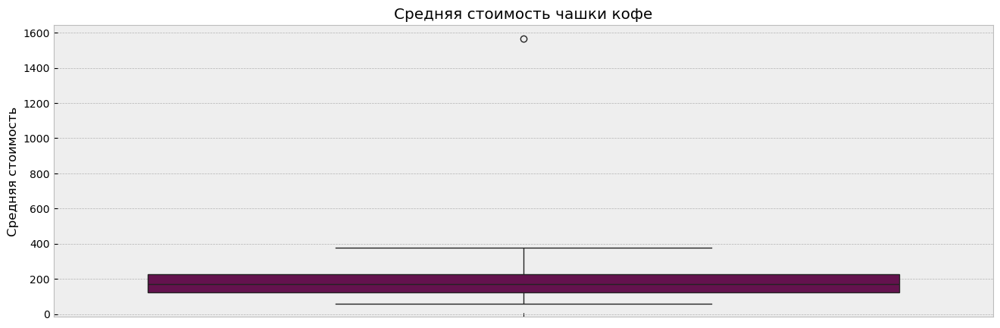

In [110]:
# посмотрим диаграмму размаха
plt.figure(figsize=(16, 5))

ax = sns.boxplot(y='middle_coffee_cup', data=df_caffee, color='#720455')

ax.set_title('Средняя стоимость чашки кофе')
ax.set_ylabel('Средняя стоимость')
plt.show()

***Среднее значение чашки кофе в Москве - 175 рублей. Поскольку среднее и медианное значения не сильно различаются между собой, будем ориентироваться на среднее значение стоимости чашки кофе. Максимальное значение чашки кофе в 1568 рублей - явный выброс, судя по графику за максимальное значение можно принять 400 рублей.***

In [111]:
# посмотрим, какие есть вообще значения в данном столбце
df_caffee['middle_coffee_cup'].unique()

array([ 170.,   nan,  145.,  150.,  180.,  120.,  100.,  256.,  160.,
        250.,  165.,  149.,  135.,  220.,  175.,  195.,   60.,  214.,
         89.,   95.,  204.,   90.,  140.,  125.,  162.,  155.,  154.,
        297.,  205.,  124.,  200.,  190.,  134.,  139.,  287.,  225.,
        230.,  237.,  290.,  254.,  279.,  174.,  179.,  295.,  285.,
        270.,   84.,  127.,   80.,  185.,  210.,  325.,  159.,  215.,
        245.,  110.,  266.,  242.,  137.,  255.,  240.,  217.,  315.,
        130.,  167.,  169.,  235.,  105., 1568.,   79.,  260.,  300.,
        291.,  275.,  115.,  328.,   94.,  265.,  184.,  229.,  164.,
        172.,  259.,  246.,  199.,  138.,  375.,  189.,  320.,  197.,
        227.,  102.,  119.,   75.,  144.,  129.])

In [113]:
# перезапишем выборку, убрав выброс, обнаруженный с помощью боксплота
df_caffee = df_caffee.drop(df_caffee[df_caffee['middle_coffee_cup'] > 400].index)

In [114]:
# проверим описательную статистику после перезаписи
df_caffee['middle_coffee_cup'].describe()

count    514.000000
mean     172.354086
std       65.830747
min       60.000000
25%      124.250000
50%      169.500000
75%      225.000000
max      375.000000
Name: middle_coffee_cup, dtype: float64

In [124]:
# посмотрим, что с количеством после удаления выброса
df_caffee.shape[0]

1400

In [125]:
# посмотрим, как распределяются средние значения чашки кофе по округам
avg_cup = df_caffee.groupby('district').agg({'middle_coffee_cup':'mean'})\
    .sort_values(by='middle_coffee_cup', ascending=False).reset_index()
round(avg_cup, 2)

,district,middle_coffee_cup
0,Западный административный округ,188.56
1,Центральный административный округ,187.52
2,Юго-Западный административный округ,184.18
3,Северный административный округ,166.34
4,Северо-Западный административный округ,165.52
5,Северо-Восточный административный округ,165.33
6,Южный административный округ,158.49
7,Юго-Восточный административный округ,151.09
8,Восточный административный округ,140.02


In [126]:
# покажем распределение средних значений чашки кофе по районам с помощью хороплета
m = Map(location=[55.751244, 37.618423], zoom_start=10, tiles='Cartodb Positron')

Choropleth(
    geo_data=geo,
    data=avg_cup,
    columns=['district', 'middle_coffee_cup'],
    key_on='feature.properties.name',
    fill_color='Oranges',
    fill_opacity=.8,
    legend_name='Средняя стоимость чашки кофе в разбивке по округам',
).add_to(m).geojson.add_child(folium.features.GeoJsonTooltip(['name',], labels=False))

# выводим карту
m

***Самые высокие значения средней стоимости чашки кофе в Западном (188.56 руб), Центральном (187.52 руб) и Юго-Западном (184.18 руб) административных округах. В Восточном административном округе самая маленькая средняя стоимость чашки кофе (140.02 руб).***

In [127]:
# посмотрим список заведений со средней ценой за чашку кофе более 250 рублей
high_price_cap = df_caffee[df_caffee['middle_coffee_cup'] > 250]
high_price_cap['name'].unique()

array(['шоколадница', 'coffee bean', 'гедонист', "jeffrey's кофе и сидр",
       'zest coffee & wine', 'кофе хауз', 'кофе & moloko', 'bloom-n-brew',
       'il tocco', 'carrots and beans', 'даблби', 'sova coffee',
       'skuratov, coffee roasters', 'кофе&moloko',
       'atelier de tartelettes', 'циники', 'кафетериус', 'собрание',
       'кофейня на остоженке', 'каннибал кофе', 'ycp',
       'дядька кофе. картель', 'espressium', 'кофе и мечты',
       'the waterfront', 'raf&gotovo', 'coffeeshop company', 'coffee fm',
       'skyline', 'диемм', 'zm coffee', 'па па кофе'], dtype=object)

In [128]:
# посмотрим, какие из них самые дорогие по значению средней чашки кофе
high_price_cap.groupby(['name', 'street', 'district', 'rating']).agg({'middle_coffee_cup':'mean'}) \
    .sort_values(by='middle_coffee_cup', ascending=False).reset_index().head(15)

,name,street,district,rating,middle_coffee_cup
0,coffee fm,Авиамоторная улица,Юго-Восточный административный округ,4.3,375.0
1,кафетериус,Большая Никитская улица,Центральный административный округ,4.3,328.0
2,шоколадница,Бутырская улица,Северный административный округ,4.1,325.0
3,диемм,3-я Фрунзенская улица,Центральный административный округ,4.3,320.0
4,il tocco,Ходынский бульвар,Северный административный округ,4.1,315.0
5,па па кофе,проспект Вернадского,Западный административный округ,4.2,300.0
6,ycp,Мясницкая улица,Центральный административный округ,4.8,300.0
7,даблби,Ярцевская улица,Западный административный округ,4.0,300.0
8,espressium,Большая Сухаревская площадь,Центральный административный округ,4.4,300.0
9,циники,Богословский переулок,Центральный административный округ,4.6,300.0


In [129]:
# посмотрим, у каких из них самый высокий рейтинг
high_price_cap.groupby(['name', 'street', 'district']).agg({'rating':'mean', 'middle_coffee_cup':'mean'}) \
    .sort_values(by='rating', ascending=False).reset_index().head(15)

,name,street,district,rating,middle_coffee_cup
0,skyline,улица Орджоникидзе,Южный административный округ,4.9,275.0
1,ycp,Мясницкая улица,Центральный административный округ,4.8,300.0
2,"skuratov, coffee roasters",Кутузовский проспект,Западный административный округ,4.8,270.0
3,"skuratov, coffee roasters",Верхняя Радищевская улица,Центральный административный округ,4.7,270.0
4,bloom-n-brew,Краснопролетарская улица,Центральный административный округ,4.7,255.0
5,the waterfront,улица Большая Полянка,Центральный административный округ,4.7,275.0
6,циники,Богословский переулок,Центральный административный округ,4.6,300.0
7,atelier de tartelettes,Спиридоньевский переулок,Центральный административный округ,4.5,275.0
8,jeffrey's кофе и сидр,Сельскохозяйственная улица,Северо-Восточный административный округ,4.5,254.0
9,"skuratov, coffee roasters",Калашный переулок,Центральный административный округ,4.5,270.0


***Среди дорогих кофеен, в которых цена за чашку кофе превышает 250 рублей оказалась и популярная сеть Шоколадница, такие модные кофейни, как Кофе Хауз, Coffeshop Company, Sova Coffee и другие.***

***Посмотрели топ 15 улиц, на которых находятся самые дорогие кофейни, самая верхняя строчка поринадлежит Авиамоторной улице и кофейне Coffee Fm. Также сгруппировали дорогие кофейни в топ 15 по самым высоким рейтингам, верхняя строчка за кофейней Skyline и улицей Орджоникидзе (которая кстати по самым высоким ценам в топ 15 не попала).***

***Посмотрим еще напоследок, в каких АО г. Москвы есть круглосуточные кофейни, и есть ли округа, в которых нет ни одной кофейни 24 на 7.***

In [130]:
# посмотрим, как обстоит дело с круглосуточными кофейнями в округах г. Москвы
df_caffee[df_caffee['is_24_7'] == True].groupby('district')['category'].count().reset_index()

,district,category
0,Восточный административный округ,5
1,Западный административный округ,9
2,Северный административный округ,5
3,Северо-Восточный административный округ,3
4,Северо-Западный административный округ,2
5,Центральный административный округ,26
6,Юго-Восточный административный округ,1
7,Юго-Западный административный округ,7
8,Южный административный округ,1


***Есть три округа, в которых совсем нет круглосуточных кофеен, это Северо-Западный АО, Южный АО и Юго-Восточный АО.***

***ВЫВОДЫ:***

- Всего в датасете представлена 1401 кофейня, из них круглосуточных - 59 объектов.
- Больше всего кофеен находится в Центральном административном округе, чуть меньше в Северном, и на последнем месте по количеству кофеен расположен Северо-Западный административный округ.
- Подавляющее большинство круглосуточных коффен сосредоточено в Центральном административном округе (26 штук).
- Самое высокое значение рейтинга у кофеен конечно же в Центральном административном округе, а также одинаково высокое - в Северо-Западном административном округе. Самый низкий рейтинг у кофеен в Западном административном округе.
- Среднее значение чашки кофе в Москве - 175 рублей.
- Самые высокие значения средней стоимости за чашку кофе в Западном (188.56 руб), Центральном (187.52 руб) и Юго-Западном (184.18 руб) административных округах. В Восточном административном округе самая маленькая средняя стоимость чашки кофе (140.02 руб).
- Из самых дорогих кофеен в списке на верхних строчках оказалась и популярная сеть Шоколадница, самой дорогой оказалась кофейня Coffee Fm на Авиамоторной улице, а самой высокую строчку по рейтингам заняла кофейня Skyline на улице Орджоникидзе.

**Рекомендации по местоположению открытия нового заведения:**

Во-первых можно рассмотреть открытие кофейни в Центральном административном округе, предпочтительно круглосуточной. Да, это самое многочисленная локация по количеству кофеен, и круглосуточных тоже, однако и самая проходимая, так как больше всего людей, тем более если установить на первое время среднюю цену чашки кофе немного меньше уровня Центрального округа, при этом сохранив качество напитков и обслуживания, можно стать конкурентоспособным заведением.

Плюс сериал "Друзья" является и по текущий день очень популярным и подобных заведений в Москве еще нет, можно попробовать воссоздать атмосферу кофейни Central Perk, творчески подойти к составлению меню и расставлению посадочных мест. Это как минимум выделит новое заведение среди остальных, что может очень позитивно сказаться на рейтинге и повышению узнаваемости новой кофейни.

Во-вторых, можно рассмотреть Западный административный округ для открытия заведения, лучше также круглосуточного, так как там самый низкий рейтинг у кофеен, можно выгодно выделиться на фоне остальных, если поддерживать качество на высоте, плюс в данном округе самая дорогая средняя стоимость чашки кофе. Если установить стоимость чашки кофе ниже среднего значения, это тоже может помочь быстро набрать популярность среди посетителей.

Ну и в-третьих, еще в Юго-Западном административном округе значения чашки кофе выше среднего по г. Москве. Здесь не так много кофеен по сравнению с другими округами (третья снизу величина от общего количества кофеен), также можно рассмотреть круглосуточный вариант.

Также еще вариант рассмотреть открытие кофейни там, где самих кофеен меньшее по всем округам количество, в Северо-Западном административном округе, хотя в качестве первого заведения на мой взгляд эта локация не подходит.

Если дела пойдут в гору, было бы неплохо организовать сеть кофеен в стилистике любимого многими сериала, и как раз начать с этих трех округов.

## Общий вывод

### Выводы после исследования рынка заведений общественного питания г. Москвы

Мы проанализировали рынок заведений общественного питания г. Москвы и сделали следующие выводы:

- Самая популярная по Москве категория заведений общепита - это кафе (2363 объекта), самая непопулярная категория - это булочные (255 объектов). 

- По г. Москва соотношение несетевых и сетевых заведений сместилось в сторону несетевых заведений (61,9 % против 38,1 %). Исключение составляют кофейни, пиццерии и булочные, для данных категорий сетевых заведений больше, чем несетевых.

- Центральный административный округ является рекордным по общему количеству заведений датасета (2242 объекта), самому высокому среднему рейтингу заведений (4.38), самым высоким медианным значениям средних чеков заведений (1000 руб), а также заведений, работающих 24 на 7 (131 объект).

- Самая популярная сеть среди сетевых заведений - это Шоколадница (117 объектов), которая имеет и практически самый высокий рейтинг среди посетителей - 4,9 балла. Если смотреть 15 самых популярных сетей заведений в Москве в разрезе по категориям,то на первой строчке кофейни. 

- Самые популярные категории независимо от регионов и других характеристик - это кафе и рестораны.

- Усредненные значения рейтингов сильно не различаются в зависимости от категории, но все же не можем не обратить внимание, что выше всего они у баров, пабов и пиццерий.

- Самая популярная улица по количеству заведений - это проспект Мира, который расположен опять же в Центральном административном округе.

- Всего в датасете представлено 458 улиц, на которых только один объект общественного питания, больше всего таких объектов находится в категории кафе (160), хотя их в принципе больше всего по количеству.

- Удаленность заведений от Центрального административного округа не особо влияет на цены в заведениях, поскольку не везде в заведениях чем удаленнее от центра, тем меньше стоимость.

- Практически во всех категориях заведений чем выше рейтинг заведения, тем выше средний чек, кроме двух категорий - кафе и пиццерий.

- Всего в датасете представлена 1401 кофейня, из них большинство (428 кофеен) и большинство круглосуточных кофеен (26) в Центральном административном округе. Также здесь самый высокий рейтинг кофеен (4,34 балла).

- Среднее значение чашки кофе в г. Москва составляет 175 рублей.

- В качестве места для открытия кофейни предлагается все же в первую очередь рассмотреть Центральный административный округ, а также Западный, Юго-Западный и как вариант Северо-Западный округа.

**Аргументы для открытия кофейни в СЗАО:**
        
1). В Северо-Западном АО меньше всего кофеен (да и вообще заведений общественного питания) по сравнению со всеми остальными округами, нет перенасыщения объектами, как, например, в ЦАО. Если заказчик нацелен серьезно на данный округ, можно провести более детальный анализ улиц СЗАО и найти те места рядом с наиболее проходимыми местами, где не помешала бы уютная кофейня :)
        
2). В СЗАО достаточно высокий средний рейтинг у заведений общепита (4.33 балла) - почти на уровне ЦАО, значит люди скорее всего активно их посещают, возможно так как их здесь не так много, уже есть полюбившиеся места, которые они высоко оценивают, и есть шанс стать одной из подобных кофеен.
        
3). Средняя стоимость чашки кофе в СЗАО (165.52 рубля) находится почти на уровне средней стоимости чашки по г. Москве (175 рублей), не самая низкая среди всех остальных округов, значит можно будет на первое время рассмотреть стоимость чуть ниже, чем у конкурентов по округу, и при этом не сильно потерять в сравнении со средней стоимостью по Москве.
        
При открытии кофейни, например, в Восточном округе средняя стоимость и так очень низка (140.02 рублей), установление цены еще ниже для нового заведения могло обернуться скорой нерентабельностью.
        
4). СЗАО - один из трех округов, где нет ни одной круглосуточной кофейни, за счет этого можно было неплохо привлечь к себе внимание и повысить лояльность любителей попить кофе в позднее время.

### Выводы о ходе исследовательского анализа данных

- В процессе исследования данных мы обнаружили большое количество пропусков в данных, однако мы их оставили, как есть.
- Мы посмотрели, что явных дубликатов не нашлось, однако было несколько неявных дубликатов (по названию заведения и адресу), данные дубликаты мы удалили. А также мы создали два новых столбца - с улицей, на которой находится заведение, а также с обозначением работающих 24 на 7 заведений.
- В процессе исследовательского анализа мы использовали различные типы графиков и диаграмм нескольких библиотек Matplotlib, Seaborn, Plotly и Folium, следующие типы визуализаций - круговые, столбчатые, диаграммы размаха, точечные, фоновые картограммы). 

Презентация: https://disk.yandex.ru/i/b_I2KZ--Jo-QwQ